# Combine Data Cleaning, Feature Selection, Modeling and Interpretability into One Report

## Author: 
- Yash Pankhania (pankhania.y@northeastern.edu)

Github Repository URL: https://github.com/Draconian10/Australia_Weather_Prediction

## Abstract:
This notebook combines data cleaning, feature selection, modeling, and interpretability to analyze the Australian weather data for predicting rain for tomorrow. First, data cleaning and feature selection were performed to identify the significant predictors and build a logistic regression model that accurately predicted rain. Next, an AutoML library, H2O AutoML, was used to explore different algorithm options and create multivariate models to predict rainfall. The use of AutoML simplified the model development process and provided insights into underlying patterns in the weather data. Finally, various models were interpreted using SHAP analysis, revealing that the logistic model provided straightforward insights, the tree-based model had a complex decision-making process, and the Auto-ML model had limited interpretability. The report emphasizes the importance of interpretability in machine learning models to gain valuable insights into their decision-making process.

## ML Data Cleaning and Feature Selection

In [1]:
# Installing H2O Library
!pip install h2o

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 177.6/177.6 MB 4.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for h2o: filename=h2o-3.40.0.3-py2.py3-none-any.whl size=177694727 sha256=2e40ef7872a3e341f3e58acfc1d1b5f38a9454460c953b8cb96c1c528df6d5f0
  Stored in directory: /root/.cache/pip/wheels/9a/54/b6/c9ab3e71309ef0000bbe39e715020dc151bbfc557784b7f4c9
Successfully built h2o


In [2]:
# Installing SHAP library
!pip install shap

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 572.4/572.4 KB 9.1 MB/s eta 0:00:00


In [3]:
# Installing LIME library
!pip install lime

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 KB 5.6 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283859 sha256=baee06e30d6905ce766aa4b1e044bbcd6c151e7bc1ad3798aed64ed373605e53
  Stored in directory: /root/.cache/pip/wheels/ed/d7/c9/5a0130d06d6310bc6cbe55220e6e72dcb8c4eff9a478717066
Successfully built lime


In [4]:
import numpy as np
import pandas as pd
import seaborn as sns
import shap # Library required to perform SHAP Analysis in Python
import lime
from lime import lime_tabular
import h2o # Library is required to use the H2O AutoML interface
from h2o.automl import H2OAutoML
import matplotlib.pyplot as plt
import warnings
%matplotlib inline
warnings.filterwarnings("ignore")

In [5]:
# Reading data from the CSV file and inserting it into a DataFrame
train_df = pd.read_csv('https://raw.githubusercontent.com/Draconian10/Australia_Weather_Prediction/main/Data_Cleaning_Feature_Selection/Weather%20Training%20Data.csv')

In [6]:
# Displaying data in the DataFrame
train_df.head()

,row ID,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,Row0,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,...,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,0
1,Row1,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,...,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,0
2,Row2,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,...,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,0
3,Row3,Albury,14.6,29.7,0.2,NaN,NaN,WNW,56.0,W,...,55.0,23.0,1009.2,1005.4,NaN,NaN,20.6,28.9,No,0
4,Row4,Albury,7.7,26.7,0.0,NaN,NaN,W,35.0,SSE,...,48.0,19.0,1013.4,1010.1,NaN,NaN,16.3,25.5,No,0


In [7]:
# Fetching number of rows and columns
train_df.shape

(99516, 23)

In [8]:
# Fetching data types of each individual columns
train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99516 entries, 0 to 99515
Data columns (total 23 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   row ID         99516 non-null  object 
 1   Location       99516 non-null  object 
 2   MinTemp        99073 non-null  float64
 3   MaxTemp        99286 non-null  float64
 4   Rainfall       98537 non-null  float64
 5   Evaporation    56985 non-null  float64
 6   Sunshine       52199 non-null  float64
 7   WindGustDir    92995 non-null  object 
 8   WindGustSpeed  93036 non-null  float64
 9   WindDir9am     92510 non-null  object 
 10  WindDir3pm     96868 non-null  object 
 11  WindSpeed9am   98581 non-null  float64
 12  WindSpeed3pm   97681 non-null  float64
 13  Humidity9am    98283 non-null  float64
 14  Humidity3pm    97010 non-null  float64
 15  Pressure9am    89768 non-null  float64
 16  Pressure3pm    89780 non-null  float64
 17  Cloud9am       61944 non-null  float64
 18  Cloud3

In [9]:
# Fetching unique values in each column
train_df.nunique()

row ID           99516
Location            49
MinTemp            386
MaxTemp            500
Rainfall           601
Evaporation        327
Sunshine           145
WindGustDir         16
WindGustSpeed       67
WindDir9am          16
WindDir3pm          16
WindSpeed9am        43
WindSpeed3pm        44
Humidity9am        101
Humidity3pm        101
Pressure9am        536
Pressure3pm        536
Cloud9am            10
Cloud3pm            10
Temp9am            432
Temp3pm            491
RainToday            2
RainTomorrow         2
dtype: int64

In [10]:
# Fetching a descriptive statistics summary of the DataFrame
train_df.describe()

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainTomorrow
count,99073.000000,99286.000000,98537.000000,56985.00000,52199.000000,93036.000000,98581.000000,97681.000000,98283.000000,97010.000000,89768.000000,89780.000000,61944.000000,59514.000000,98902.000000,97612.000000,99516.000000
mean,12.176266,23.218513,2.353024,5.46132,7.615090,39.976966,14.004849,18.650464,68.866376,51.433296,1017.684638,1015.286204,4.447985,4.519122,16.970041,21.681340,0.224677
std,6.390882,7.115072,8.487866,4.16249,3.783008,13.581524,8.902323,8.801827,19.074951,20.777616,7.110166,7.045189,2.886580,2.716618,6.488961,6.931681,0.417372
min,-8.500000,-4.100000,0.000000,0.00000,0.000000,6.000000,0.000000,0.000000,0.000000,0.000000,980.500000,978.200000,0.000000,0.000000,-7.000000,-5.100000,0.000000
25%,7.600000,17.900000,0.000000,2.60000,4.800000,31.000000,7.000000,13.000000,57.000000,37.000000,1013.000000,1010.500000,1.000000,2.000000,12.300000,16.600000,0.000000
50%,12.000000,22.600000,0.000000,4.80000,8.400000,39.000000,13.000000,19.000000,70.000000,52.000000,1017.700000,1015.300000,5.000000,5.000000,16.700000,21.100000,0.000000
75%,16.800000,28.200000,0.800000,7.40000,10.600000,48.000000,19.000000,24.000000,83.000000,65.000000,1022.400000,1020.000000,7.000000,7.000000,21.500000,26.400000,0.000000
max,33.900000,48.100000,371.000000,86.20000,14.500000,135.000000,130.000000,87.000000,100.000000,100.000000,1041.000000,1039.600000,9.000000,9.000000,40.200000,46.700000,1.000000


In [11]:
# Dropping unwanted columns from the DataFrame
train_df.drop(columns='row ID', inplace=True)
train_df.head()

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,WNW,...,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,0
1,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,WSW,...,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,0
2,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,NW,...,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,0
3,Albury,14.6,29.7,0.2,NaN,NaN,WNW,56.0,W,W,...,55.0,23.0,1009.2,1005.4,NaN,NaN,20.6,28.9,No,0
4,Albury,7.7,26.7,0.0,NaN,NaN,W,35.0,SSE,W,...,48.0,19.0,1013.4,1010.1,NaN,NaN,16.3,25.5,No,0


In [12]:
# Searching for NULL values in the DataFrame
train_df.isnull().sum()

Location             0
MinTemp            443
MaxTemp            230
Rainfall           979
Evaporation      42531
Sunshine         47317
WindGustDir       6521
WindGustSpeed     6480
WindDir9am        7006
WindDir3pm        2648
WindSpeed9am       935
WindSpeed3pm      1835
Humidity9am       1233
Humidity3pm       2506
Pressure9am       9748
Pressure3pm       9736
Cloud9am         37572
Cloud3pm         40002
Temp9am            614
Temp3pm           1904
RainToday          979
RainTomorrow         0
dtype: int64

In [13]:
# Replacing the string value 'NA' with NaN in the DataFrame
train_df['RainToday'] = train_df['RainToday'].replace('NA', np.nan)

In [14]:
# Displaying data in the DataFrame
train_df.head()

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,WNW,...,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,0
1,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,WSW,...,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,0
2,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,NW,...,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,0
3,Albury,14.6,29.7,0.2,NaN,NaN,WNW,56.0,W,W,...,55.0,23.0,1009.2,1005.4,NaN,NaN,20.6,28.9,No,0
4,Albury,7.7,26.7,0.0,NaN,NaN,W,35.0,SSE,W,...,48.0,19.0,1013.4,1010.1,NaN,NaN,16.3,25.5,No,0


## Data Visualization

### QQ Plot
A Q-Q (Quantile-Quantile) plot is a graphical representation of the distribution of two datasets, usually the observed and expected (theoretical) distributions. It is used to assess whether a set of data follows a specified theoretical distribution, such as a normal distribution.

In a Q-Q plot, the quantiles of the two datasets are plotted against each other. If the observed data follows the theoretical distribution, the points on the plot will approximately lie on a straight line. Deviations from a straight line indicate that the observed data deviates from the specified theoretical distribution.

Refer: https://www.statsmodels.org/dev/generated/statsmodels.graphics.gofplots.qqplot.html

<Figure size 800x500 with 0 Axes>

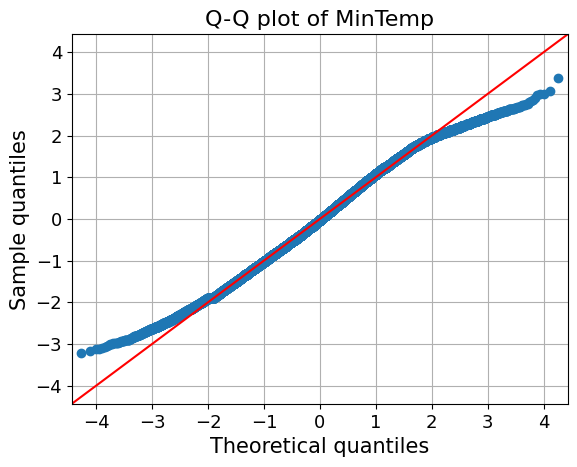

<Figure size 800x500 with 0 Axes>

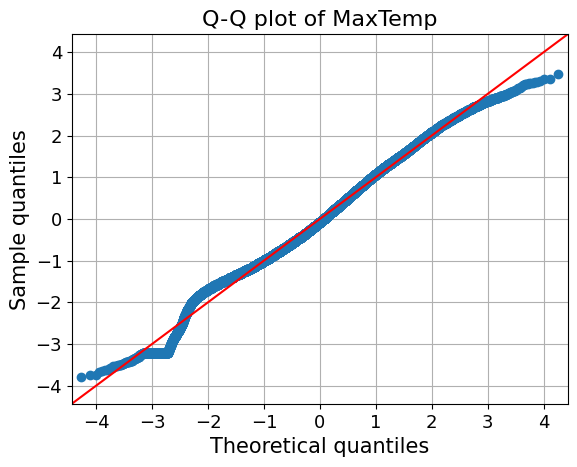

<Figure size 800x500 with 0 Axes>

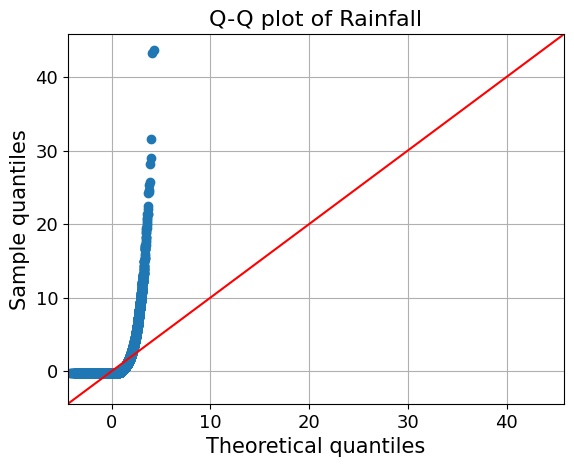

<Figure size 800x500 with 0 Axes>

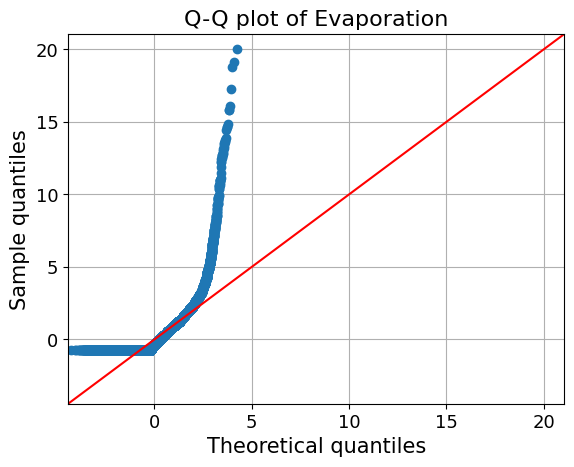

<Figure size 800x500 with 0 Axes>

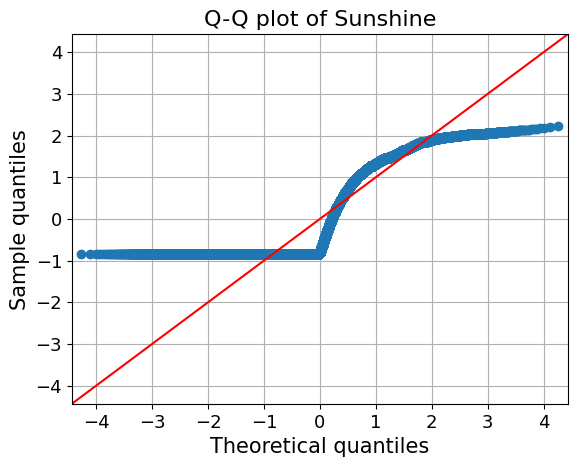

<Figure size 800x500 with 0 Axes>

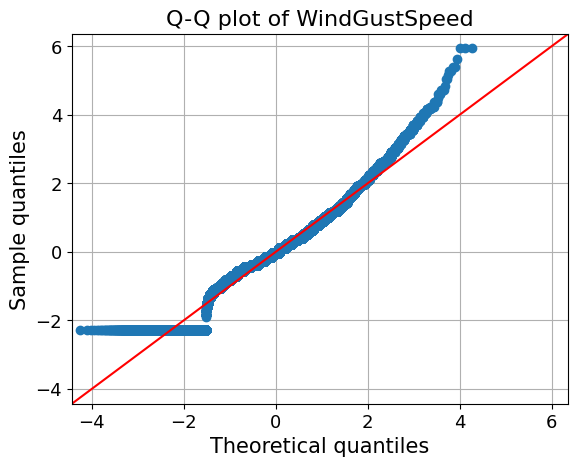

<Figure size 800x500 with 0 Axes>

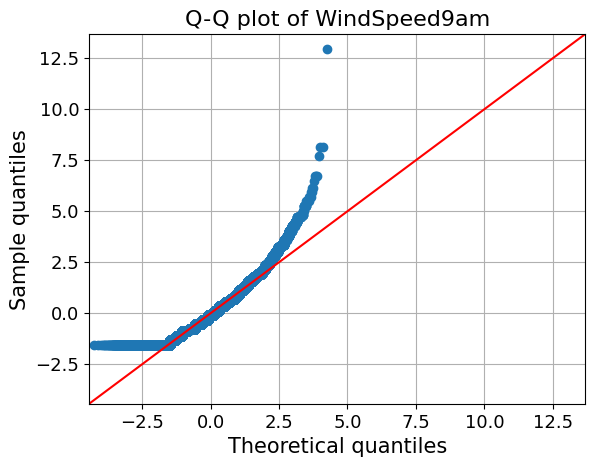

<Figure size 800x500 with 0 Axes>

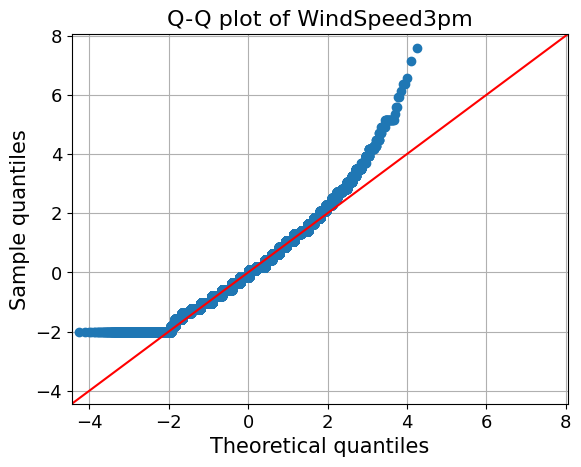

<Figure size 800x500 with 0 Axes>

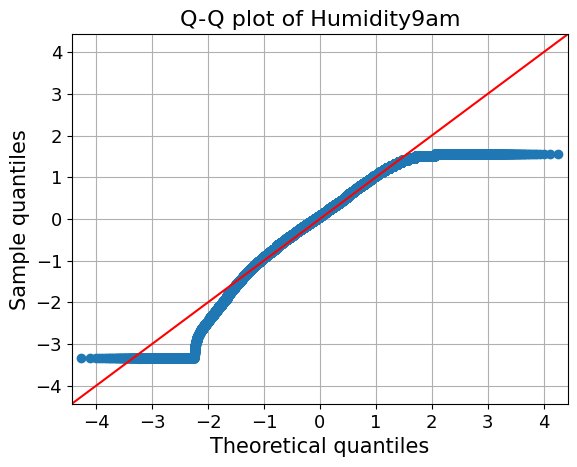

<Figure size 800x500 with 0 Axes>

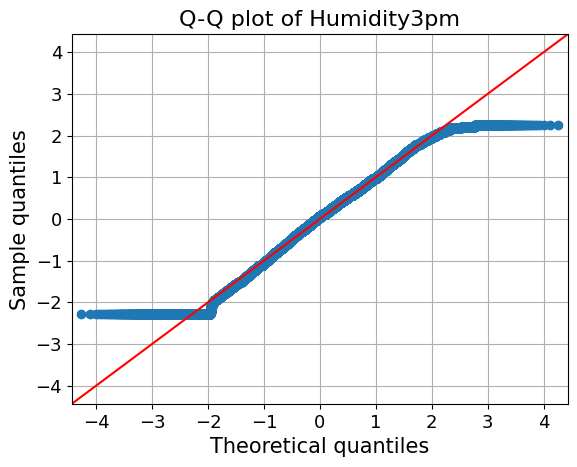

<Figure size 800x500 with 0 Axes>

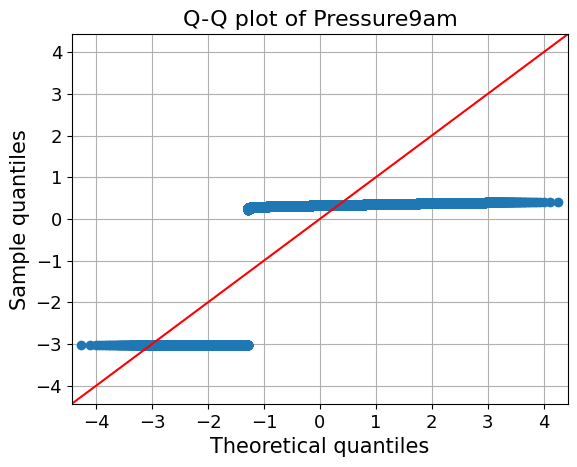

<Figure size 800x500 with 0 Axes>

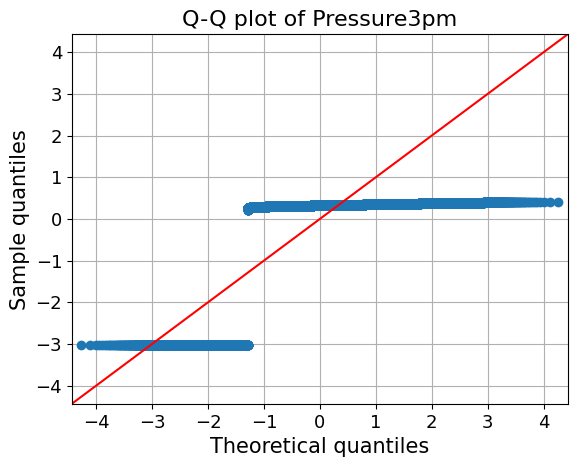

<Figure size 800x500 with 0 Axes>

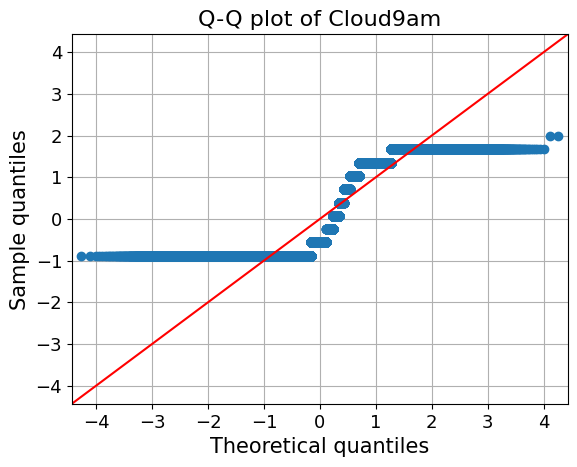

<Figure size 800x500 with 0 Axes>

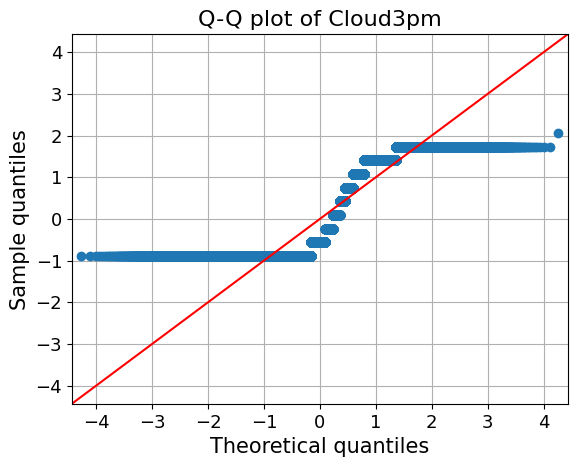

<Figure size 800x500 with 0 Axes>

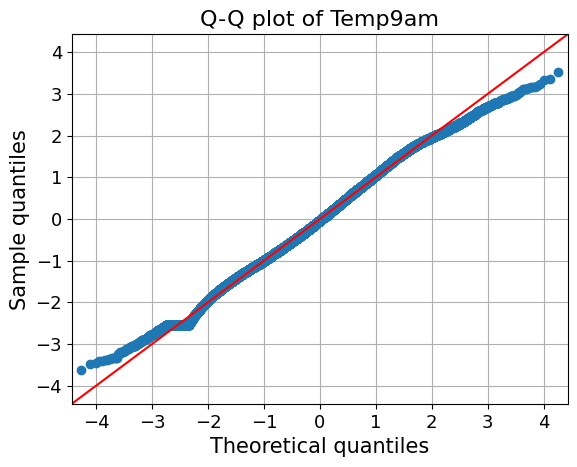

<Figure size 800x500 with 0 Axes>

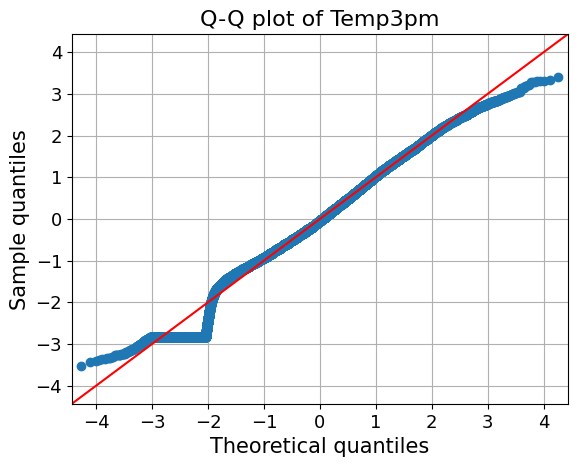

In [15]:
# Checking distribution of independent variables
from statsmodels.graphics.gofplots import qqplot
data_norm= train_df[['MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine', 'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am', 'Temp3pm']].fillna(0)
for c in data_norm.columns[:]:
  plt.figure(figsize=(8,5))
  fig=qqplot(data_norm[c],line='45',fit='True')
  plt.xticks(fontsize=13)
  plt.yticks(fontsize=13)
  plt.xlabel("Theoretical quantiles",fontsize=15)
  plt.ylabel("Sample quantiles",fontsize=15)
  plt.title("Q-Q plot of {}".format(c),fontsize=16)
  plt.grid(True)
  plt.show()

- As observed from the above QQ plot, most of the predictor variables follow the normal distribution
- There are outliers observed in certain predictor variables like Rainfall and Evaporation which needs to be removed for increased accuracy

In [16]:
# Fetching numeric columns of the main data set for further processing
numeric_col = train_df[['MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine', 'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am',
       'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am', 'Temp3pm']]

# Fetching categorical columns of the main data set for further processing
categorical_col = train_df[['Location', 'WindGustDir', 'WindDir9am', 'WindDir3pm', 'RainToday']]

In [17]:
# Fetching numeric columns of the main data set for further processing
numeric_automl_col = train_df[['MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine', 'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am',
       'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am', 'Temp3pm', 'RainTomorrow']]

# Fetching categorical columns of the main data set for further processing
categorical_automl_col = train_df[['Location', 'WindGustDir', 'WindDir9am', 'WindDir3pm', 'RainToday']]

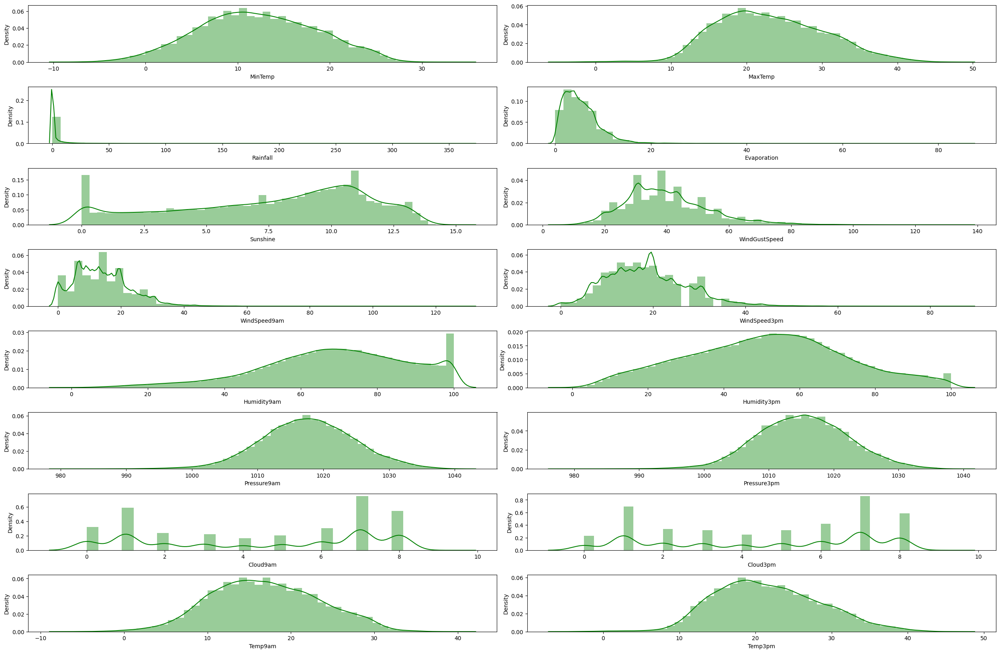

In [18]:
# Plotting a histogram to show the distribution of numeric variables
rows = 10
cols = 2
counter = 1
plt.rcParams['figure.figsize'] = [25, 20]
for i in numeric_col.columns:
    plt.subplot(rows, cols, counter)
    sns.distplot(train_df[i], color = 'Green')
    counter+=1
plt.tight_layout()
plt.show()

As observed, the distribution of numeric variables is as follows:
- MinTemp

  It is normally distributed

- MaxTemp

  It is normally distributed

- Rainfall

  It contains a lot of outliers which need to be removed to assess the distribution

- Evaporation

  It is right skewed

- Sunshine

  It looks pretty close to normal distribution

- WindGustSpeed

  It is right skewed

- WindSpeed9am

  It is right skewed

- WindSpeed3pm

  It is right skewed

- Humidity9am

  It is normally distributed

- Humidity3pm

  It is normally distributed

- Pressure9am

  It is normally distributed

- Pressure3pm

  It is normally distributed

- Cloud9am

  It is distributed with a very small range of values

- Cloud3pm

  It is distributed with a very small range of values

- Temp9am

  It is normally distributed

- Temp3pm

  It is normally distributed

<Axes: >

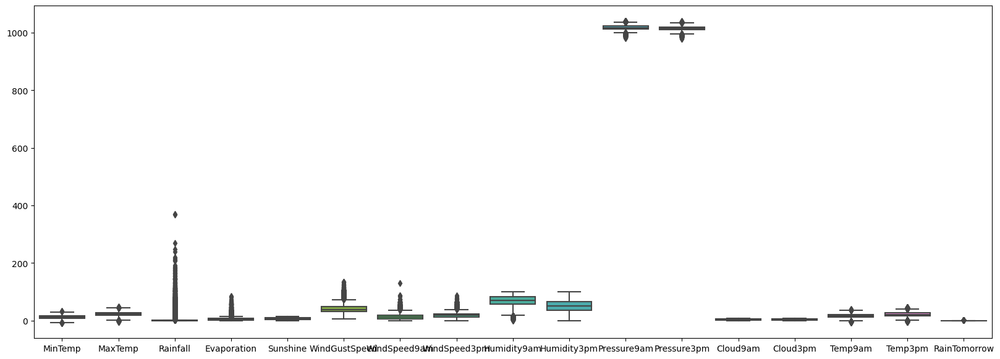

In [19]:
#Checking the Ranges of the predictor variables and dependent variable
plt.figure(figsize=(20,7))
sns.boxplot(data=train_df)

In [20]:
# Generating correlation of data set
train_df.corr()

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainTomorrow
MinTemp,1.000000,0.736875,0.104381,0.472989,0.075160,0.178870,0.178109,0.174126,-0.236926,0.004391,-0.453020,-0.463388,0.072978,0.017827,0.902106,0.709646,0.084531
MaxTemp,0.736875,1.000000,-0.074307,0.595553,0.469390,0.071328,0.018079,0.050841,-0.507118,-0.509828,-0.335206,-0.429688,-0.291580,-0.278339,0.887055,0.984583,-0.159600
Rainfall,0.104381,-0.074307,1.000000,-0.066607,-0.226291,0.134978,0.088074,0.061296,0.221816,0.254877,-0.167112,-0.125644,0.195769,0.168513,0.011792,-0.079467,0.238673
Evaporation,0.472989,0.595553,-0.066607,1.000000,0.366921,0.205621,0.196003,0.127657,-0.508250,-0.394670,-0.275554,-0.299105,-0.189822,-0.183065,0.550939,0.580341,-0.115249
Sunshine,0.075160,0.469390,-0.226291,0.366921,1.000000,-0.028070,0.011742,0.056013,-0.489601,-0.627573,0.037629,-0.021898,-0.673911,-0.702497,0.291211,0.489193,-0.448849
WindGustSpeed,0.178870,0.071328,0.134978,0.205621,-0.028070,1.000000,0.605928,0.686974,-0.219033,-0.028536,-0.459155,-0.414703,0.068606,0.107094,0.153288,0.035890,0.234079
WindSpeed9am,0.178109,0.018079,0.088074,0.196003,0.011742,0.605928,1.000000,0.518251,-0.274180,-0.031865,-0.229440,-0.176732,0.023075,0.053459,0.132218,0.007739,0.091227
WindSpeed3pm,0.174126,0.050841,0.061296,0.127657,0.056013,0.686974,0.518251,1.000000,-0.146106,0.015558,-0.295857,-0.255049,0.054920,0.027031,0.162756,0.028095,0.088844
Humidity9am,-0.236926,-0.507118,0.221816,-0.508250,-0.489601,-0.219033,-0.274180,-0.146106,1.000000,0.666067,0.142630,0.189839,0.448979,0.353328,-0.475141,-0.501223,0.255922
Humidity3pm,0.004391,-0.509828,0.254877,-0.394670,-0.627573,-0.028536,-0.031865,0.015558,0.666067,1.000000,-0.024282,0.054166,0.513929,0.520199,-0.222325,-0.558402,0.445005


<Axes: >

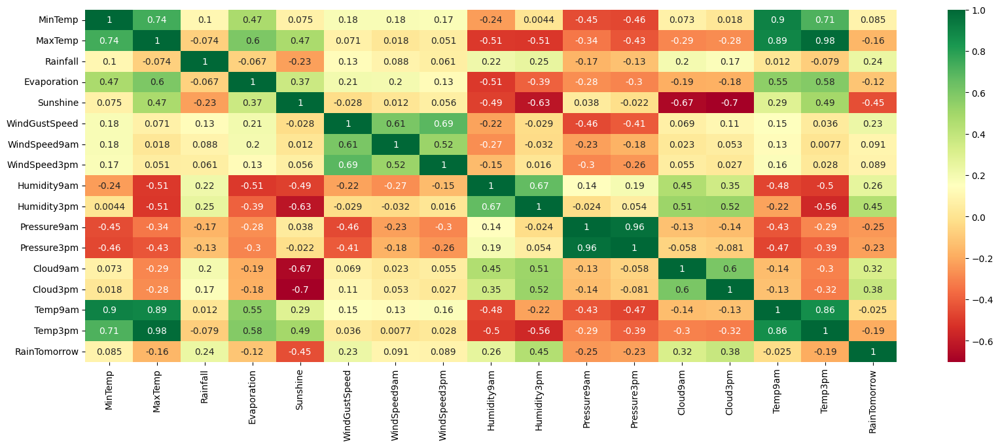

In [21]:
# Plotting Heat Map to check correlation for the data set
plt.figure(figsize=(20,7))
sns.heatmap(train_df.corr(), annot=True, cmap='RdYlGn')

We can see that lots of variables have high correlation upon other predictor variables. The highest correlation observed is between Temp3pm and MaxTemp which shows presence of multicollinearity.

## One Hot Encoding 

One-hot encoding is a process of converting categorical variables into numerical variables, also known as dummy variables. It involves converting each categorical value into a new binary feature, with a value of 1 indicating the presence of a specific category value in a data sample, and 0 indicating its absence. Each category value in the original feature will result in a separate feature column in the resulting one-hot encoded data.

Refer: https://www.geeksforgeeks.org/ml-one-hot-encoding-of-datasets-in-python/

In [22]:
from sklearn.preprocessing import OneHotEncoder # Library is used to encode the categorical variables for further processing

In [23]:
train_df.head()

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,WNW,...,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,0
1,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,WSW,...,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,0
2,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,NW,...,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,0
3,Albury,14.6,29.7,0.2,NaN,NaN,WNW,56.0,W,W,...,55.0,23.0,1009.2,1005.4,NaN,NaN,20.6,28.9,No,0
4,Albury,7.7,26.7,0.0,NaN,NaN,W,35.0,SSE,W,...,48.0,19.0,1013.4,1010.1,NaN,NaN,16.3,25.5,No,0


In [24]:
# Replacing Null Categorical values with the mode of that column
for i in train_df[['Location', 'WindGustDir', 'WindGustDir', 'WindDir9am', 'WindDir3pm', 'RainToday']]:
    train_df[i].fillna(train_df[i].mode()[0], inplace=True)

In [25]:
# Searching for NULL values in the DataFrame
train_df.isnull().sum()

Location             0
MinTemp            443
MaxTemp            230
Rainfall           979
Evaporation      42531
Sunshine         47317
WindGustDir          0
WindGustSpeed     6480
WindDir9am           0
WindDir3pm           0
WindSpeed9am       935
WindSpeed3pm      1835
Humidity9am       1233
Humidity3pm       2506
Pressure9am       9748
Pressure3pm       9736
Cloud9am         37572
Cloud3pm         40002
Temp9am            614
Temp3pm           1904
RainToday            0
RainTomorrow         0
dtype: int64

In [26]:
# Creating an instance of the OneHotEncoder class
encoder = OneHotEncoder()

# Encoding the categorical variables using the fit_transform method
encoded_data = encoder.fit_transform(train_df[['Location', 'WindGustDir', 'WindGustDir', 'WindDir9am', 'WindDir3pm', 'RainToday']])

# Converting the encoded data to a DataFrame
encoded_df = pd.DataFrame(encoded_data.toarray(), columns=encoder.get_feature_names_out(['Location', 'WindGustDir', 'WindGustDir', 'WindDir9am', 'WindDir3pm', 'RainToday']))

# Printing the encoded DataFrame
encoded_df.head()

,Location_Adelaide,Location_Albany,Location_Albury,Location_AliceSprings,Location_BadgerysCreek,Location_Ballarat,Location_Bendigo,Location_Brisbane,Location_Cairns,Location_Canberra,...,WindDir3pm_S,WindDir3pm_SE,WindDir3pm_SSE,WindDir3pm_SSW,WindDir3pm_SW,WindDir3pm_W,WindDir3pm_WNW,WindDir3pm_WSW,RainToday_No,RainToday_Yes
0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0
1,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0
2,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
3,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
4,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0


In [27]:
# Removing the old categorical columns from the DataFrame after encoding
train_df = train_df.drop(columns=['Location', 'WindGustDir', 'WindGustDir', 'WindDir9am', 'WindDir3pm', 'RainToday'])

In [28]:
# Concatenating the encoded DataFrame with the main DataFrame
final_train_df = pd.concat([train_df, encoded_df], axis=1)

## Imputation

Imputation techniques are methods used to fill missing or incomplete values in a dataset. There are several imputation techniques available, including:

- Mean Imputation
- Median Imputation
- Most Frequent Imputation
- KNN Imputation
- MICE Imputation

Refer: https://towardsdatascience.com/6-different-ways-to-compensate-for-missing-values-data-imputation-with-examples-6022d9ca0779

### Simple Imputer

The SimpleImputer is a class in scikit-learn's preprocessing library that provides basic strategies for imputing missing values. It supports replacing missing values using the mean, median, most frequent (mode), or a constant value. SimpleImputer works by transforming the dataset in-place by replacing the missing values with the desired imputed values.

Refer: https://scikit-learn.org/stable/modules/generated/sklearn.impute.SimpleImputer.html

### Median Imputation

In [29]:
from sklearn.impute import SimpleImputer # Library is required to perform Simple Imputation
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score

In [30]:
# Remove a certain percentage of data randomly
percentage = [0.01, 0.05, 0.10]
numeric_train_df = final_train_df[~final_train_df.isnull().any(axis=1)]

for i in percentage:

    # Randomly replacing 1%, 5% and 10% data from the DataFrame with NaN values
    missing_mask = np.random.rand(numeric_train_df.shape[0], numeric_train_df.shape[1]) < i
    train_df_missing = numeric_train_df.copy()
    train_df_missing[missing_mask] = np.nan

    # Initialize the SimpleImputer using Most Frequent strategy
    imputer = SimpleImputer(strategy='median')

    # Fit the imputer on the training set
    imputer.fit(train_df_missing)

    # Use the imputer to transform the training set
    train_df_imputed = imputer.transform(train_df_missing)

    # Calculate the mean absolute error (MAE), mean squared error (MSE) and Correlation (R2)
    mae = mean_absolute_error(numeric_train_df, train_df_imputed)
    mse = mean_squared_error(numeric_train_df, train_df_imputed)
    r2 = r2_score(numeric_train_df, train_df_imputed)

    # Calculate the residuals (actual values - predicted values)
    residuals = abs(numeric_train_df - train_df_imputed)

    # Calculate the mean of the residuals
    residual_mean = np.mean(residuals)

    # Calculate Bias and Variance
    residual_variance = np.mean(np.var(residuals))
    bias = np.mean(residual_mean**2)

    # Calculate Percent Error on Residuals
    per_error = (np.mean(np.sum(residuals) / np.sum(numeric_train_df))) * 100

    # Print the results
    print("Mean Absolute Error for " + str(i*100) + "% of missing values:", round(mae, 5))
    print("Mean Squared Error for " + str(i*100) + "% of missing values:", round(mse, 5))
    print("R-Squared for " + str(i*100) + "% of missing values:", round(r2, 5))
    print("Bias: ", round(bias, 5))
    print("Percent Error on Residuals: ", round(per_error, 5))
    print("Variance: ", round(residual_variance, 5), "\n")

Mean Absolute Error for 1.0% of missing values: 0.00807
Mean Squared Error for 1.0% of missing values: 0.11218
R-Squared for 1.0% of missing values: 0.99123
Bias:  0.00068
Percent Error on Residuals:  0.9036
Variance:  0.1115 

Mean Absolute Error for 5.0% of missing values: 0.04027
Mean Squared Error for 5.0% of missing values: 0.56014
R-Squared for 5.0% of missing values: 0.9559
Bias:  0.017
Percent Error on Residuals:  4.55122
Variance:  0.54314 

Mean Absolute Error for 10.0% of missing values: 0.08117
Mean Squared Error for 10.0% of missing values: 1.12123
R-Squared for 10.0% of missing values: 0.91237
Bias:  0.06829
Percent Error on Residuals:  9.00406
Variance:  1.05294 



#### Most Frequent Imputation

In [31]:
# Remove a certain percentage of data randomly
percentage = [0.01, 0.05, 0.10]
numeric_train_df = final_train_df[~final_train_df.isnull().any(axis=1)]

for i in percentage:

    # Randomly replacing 1%, 5% and 10% data from the DataFrame with NaN values
    missing_mask = np.random.rand(numeric_train_df.shape[0], numeric_train_df.shape[1]) < i
    train_df_missing = numeric_train_df.copy()
    train_df_missing[missing_mask] = np.nan

    # Initialize the SimpleImputer with strategy='median'
    imputer = SimpleImputer(strategy='most_frequent')

    # Fit the imputer on the training set
    imputer.fit(train_df_missing)

    # Use the imputer to transform the training set
    train_df_imputed = imputer.transform(train_df_missing)

    # Calculate the mean absolute error (MAE), mean squared error (MSE) and Correlation (R2)
    mae = mean_absolute_error(numeric_train_df, train_df_imputed)
    mse = mean_squared_error(numeric_train_df, train_df_imputed)
    r2 = r2_score(numeric_train_df, train_df_imputed)

    # Calculate the residuals (actual values - predicted values)
    residuals = abs(numeric_train_df - train_df_imputed)

    # Calculate the mean of the residuals
    residual_mean = np.mean(residuals)

    # Calculate Bias and Variance
    residual_variance = np.mean(np.var(residuals))
    bias = np.mean(residual_mean**2)

    # Calculate Percent Error on Residuals
    per_error = (np.mean(np.sum(residuals) / np.sum(numeric_train_df))) * 100

    # Print the results
    print("Mean Absolute Error for " + str(i*100) + "% of missing values:", round(mae, 5))
    print("Mean Squared Error for " + str(i*100) + "% of missing values:", round(mse, 5))
    print("R-Squared for " + str(i*100) + "% of missing values:", round(r2, 5))
    print("Bias: ", round(bias, 5))
    print("Percent Error on Residuals: ", round(per_error, 5))
    print("Variance: ", round(residual_variance, 5), "\n")

Mean Absolute Error for 1.0% of missing values: 0.00872
Mean Squared Error for 1.0% of missing values: 0.12186
R-Squared for 1.0% of missing values: 0.99084
Bias:  0.00074
Percent Error on Residuals:  0.89127
Variance:  0.12112 

Mean Absolute Error for 5.0% of missing values: 0.04308
Mean Squared Error for 5.0% of missing values: 0.61175
R-Squared for 5.0% of missing values: 0.95379
Bias:  0.01858
Percent Error on Residuals:  4.51989
Variance:  0.59317 

Mean Absolute Error for 10.0% of missing values: 0.08648
Mean Squared Error for 10.0% of missing values: 1.23717
R-Squared for 10.0% of missing values: 0.90666
Bias:  0.07421
Percent Error on Residuals:  9.10639
Variance:  1.16296 



### MICE Imputation

MICE (Multivariate Imputation by Chained Equations) is a statistical imputation technique that handles missing data in a dataset. It works by creating multiple imputed datasets and then combining the results to get a final imputed dataset. 

The idea behind this technique is to use the information in other variables to predict the missing values in each variable.

Refer: https://scikit-learn.org/stable/modules/impute.html

In [32]:
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer # Library is required to perform Multivariate Imputation by Chained Equations (MICE) Imputation

In [33]:
# Remove a certain percentage of data randomly
percentage = [0.01, 0.05, 0.10]
numeric_train_df = final_train_df[~final_train_df.isnull().any(axis=1)]

for i in percentage:
    
    # Randomly replacing 1%, 5% and 10% data from the DataFrame with NaN values
    missing_mask = np.random.rand(numeric_train_df.shape[0], numeric_train_df.shape[1]) < i
    train_df_missing = numeric_train_df.copy()
    train_df_missing[missing_mask] = np.nan

    # Use MICE to fill in missing values
    imputer = IterativeImputer(random_state=0, n_nearest_features=3)
    X_filled_mice = imputer.fit_transform(train_df_missing)


    # Calculate the mean absolute error (MAE), mean squared error (MSE) and Correlation (R2)
    mae = mean_absolute_error(numeric_train_df, X_filled_mice)
    mse = mean_squared_error(numeric_train_df, X_filled_mice)
    r2 = r2_score(numeric_train_df, X_filled_mice)

    # Calculate the residuals (actual values - predicted values)
    residuals = abs(numeric_train_df - X_filled_mice)

    # Calculate the mean of the residuals
    residual_mean = np.mean(residuals)

    # Calculate Bias and Variance
    residual_variance = np.mean(np.var(residuals))
    bias = np.mean(residual_mean**2)

    # Calculate Percent Error on Residuals
    per_error = (np.mean(np.sum(residuals) / np.sum(numeric_train_df))) * 100

    # Print the results
    print("Mean Absolute Error for " + str(i*100) + "% of missing values:", round(mae, 5))
    print("Mean Squared Error for " + str(i*100) + "% of missing values:", round(mse, 5))
    print("R-Squared for " + str(i*100) + "% of missing values:", round(r2, 5))
    print("Bias: ", round(bias, 5))
    print("Percent Error on Residuals: ", round(per_error, 5))
    print("Variance: ", round(residual_variance, 5), "\n")

Mean Absolute Error for 1.0% of missing values: 0.00678
Mean Squared Error for 1.0% of missing values: 0.07489
R-Squared for 1.0% of missing values: 0.9939
Bias:  0.00046
Percent Error on Residuals:  1.26506
Variance:  0.07442 

Mean Absolute Error for 5.0% of missing values: 0.03484
Mean Squared Error for 5.0% of missing values: 0.39572
R-Squared for 5.0% of missing values: 0.96591
Bias:  0.01236
Percent Error on Residuals:  7.07202
Variance:  0.38336 

Mean Absolute Error for 10.0% of missing values: 0.0677
Mean Squared Error for 10.0% of missing values: 0.79937
R-Squared for 10.0% of missing values: 0.93187
Bias:  0.0473
Percent Error on Residuals:  14.15514
Variance:  0.75208 



##### Comparing the three imputation methods, we observed that MICE Imputation fits the best upon this data set since its R2 score remains the highest among the three, the higher the percentage of data is considered. Therefore, we use MICE Imputation to impute all the NaN values in the main DataFrame.

In [34]:
# Using MICE Imputation to impute Missing Values
final_train_df = pd.DataFrame(imputer.fit_transform(final_train_df), columns = final_train_df.columns)


In [35]:
final_train_df.head()

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,...,WindDir3pm_S,WindDir3pm_SE,WindDir3pm_SSE,WindDir3pm_SSW,WindDir3pm_SW,WindDir3pm_W,WindDir3pm_WNW,WindDir3pm_WSW,RainToday_No,RainToday_Yes
0,13.4,22.9,0.6,5.265185,9.270800,44.0,20.0,24.0,71.0,22.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0
1,7.4,25.1,0.0,7.506115,10.041269,44.0,4.0,22.0,44.0,25.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0
2,17.5,32.3,1.0,6.525070,6.195270,41.0,7.0,20.0,82.0,33.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
3,14.6,29.7,0.2,8.142001,10.227973,56.0,19.0,24.0,55.0,23.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
4,7.7,26.7,0.0,7.366911,10.577251,35.0,6.0,17.0,48.0,19.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0


In [36]:
# Searching for NULL values in the DataFrame
final_train_df.isnull().sum()

MinTemp           0
MaxTemp           0
Rainfall          0
Evaporation       0
Sunshine          0
                 ..
WindDir3pm_W      0
WindDir3pm_WNW    0
WindDir3pm_WSW    0
RainToday_No      0
RainToday_Yes     0
Length: 132, dtype: int64

In [37]:
# Fetching numeric variables inside a DataFrame for further processing
numeric_df = final_train_df[['MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine', 'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am',
       'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am', 'Temp3pm']]
numeric_df.head()

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm
0,13.4,22.9,0.6,5.265185,9.270800,44.0,20.0,24.0,71.0,22.0,1007.7,1007.1,8.000000,4.839468,16.9,21.8
1,7.4,25.1,0.0,7.506115,10.041269,44.0,4.0,22.0,44.0,25.0,1010.6,1007.8,4.511880,3.495782,17.2,24.3
2,17.5,32.3,1.0,6.525070,6.195270,41.0,7.0,20.0,82.0,33.0,1010.8,1006.0,7.000000,8.000000,17.8,29.7
3,14.6,29.7,0.2,8.142001,10.227973,56.0,19.0,24.0,55.0,23.0,1009.2,1005.4,4.511880,3.429891,20.6,28.9
4,7.7,26.7,0.0,7.366911,10.577251,35.0,6.0,17.0,48.0,19.0,1013.4,1010.1,4.696809,3.339416,16.3,25.5


### Correlation

Correlation is a statistical measure that indicates the extent to which two or more variables fluctuate together. It ranges from -1 to 1, with -1 indicating a perfect negative correlation, 1 indicating a perfect positive correlation, and 0 indicating no correlation at all. 

A positive correlation means the variables increase or decrease together, while a negative correlation means that as one variable increases, the other decreases.

Refer: https://www.geeksforgeeks.org/exploring-correlation-in-python/

In [38]:
# Checking correlation between all the features in the data
final_train_df.corr()

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,...,WindDir3pm_S,WindDir3pm_SE,WindDir3pm_SSE,WindDir3pm_SSW,WindDir3pm_SW,WindDir3pm_W,WindDir3pm_WNW,WindDir3pm_WSW,RainToday_No,RainToday_Yes
MinTemp,1.000000,0.735594,0.102832,0.513117,0.062123,0.182422,0.177524,0.170912,-0.241835,-0.006335,...,-0.011600,0.055701,0.023766,-0.035706,-0.046061,-0.078525,-0.045896,-0.059102,-0.057280,0.057280
MaxTemp,0.735594,1.000000,-0.074246,0.682421,0.471671,0.076528,0.017804,0.048406,-0.510573,-0.515405,...,-0.057914,0.006546,-0.012864,-0.062071,-0.055115,-0.070606,-0.026194,-0.059820,0.225302,-0.225302
Rainfall,0.102832,-0.074246,1.000000,-0.086206,-0.227973,0.128258,0.086738,0.060389,0.222065,0.253884,...,0.020048,0.010463,0.013431,0.025365,0.011486,0.016264,0.009778,0.012460,-0.498676,0.498676
Evaporation,0.513117,0.682421,-0.086206,1.000000,0.408710,0.203972,0.188131,0.163045,-0.592724,-0.482068,...,-0.013872,0.007200,0.018156,-0.016345,-0.003116,-0.038516,-0.030168,-0.013267,0.215669,-0.215669
Sunshine,0.062123,0.471671,-0.227973,0.408710,1.000000,-0.024064,-0.003447,0.022148,-0.516481,-0.718866,...,-0.037263,-0.016249,-0.021870,-0.022478,0.018699,-0.005090,0.004143,0.013015,0.330450,-0.330450
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
WindDir3pm_W,-0.078525,-0.070606,0.016264,-0.038516,-0.005090,0.088868,0.027505,0.060177,0.003673,-0.017245,...,-0.073041,-0.091501,-0.071458,-0.066484,-0.071846,1.000000,-0.069507,-0.072965,-0.046430,0.046430
WindDir3pm_WNW,-0.045896,-0.026194,0.009778,-0.030168,0.004143,0.085999,0.015019,0.057429,-0.002083,-0.033584,...,-0.068176,-0.085407,-0.066699,-0.062056,-0.067061,-0.069507,1.000000,-0.068105,-0.030469,0.030469
WindDir3pm_WSW,-0.059102,-0.059820,0.012460,-0.013267,0.013015,0.051608,0.015067,0.041074,-0.008537,-0.016957,...,-0.071568,-0.089656,-0.070017,-0.065143,-0.070397,-0.072965,-0.068105,1.000000,-0.045505,0.045505
RainToday_No,-0.057280,0.225302,-0.498676,0.215669,0.330450,-0.147714,-0.098958,-0.079941,-0.349284,-0.379065,...,-0.031236,-0.007370,-0.010036,-0.045359,-0.038936,-0.046430,-0.030469,-0.045505,1.000000,-1.000000


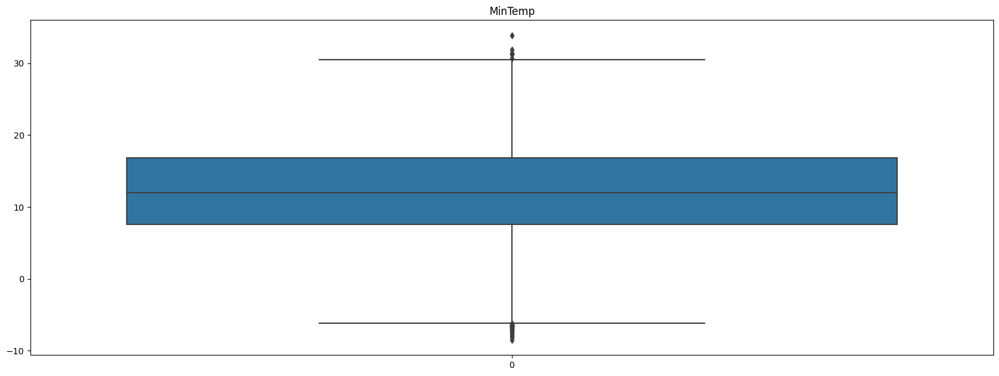

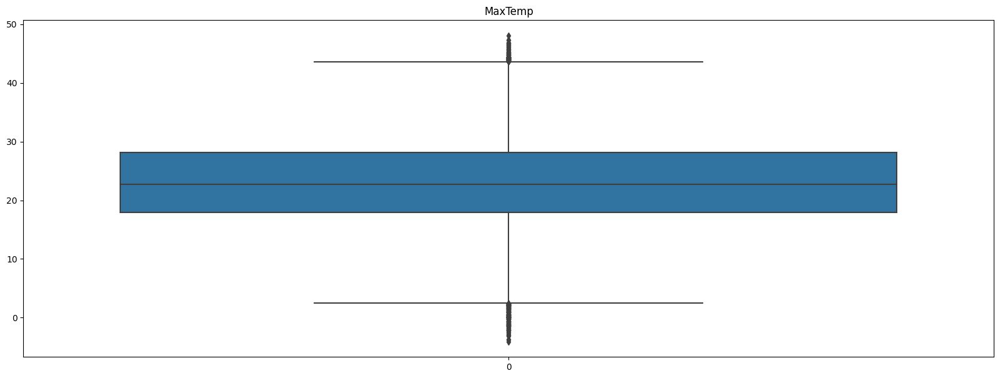

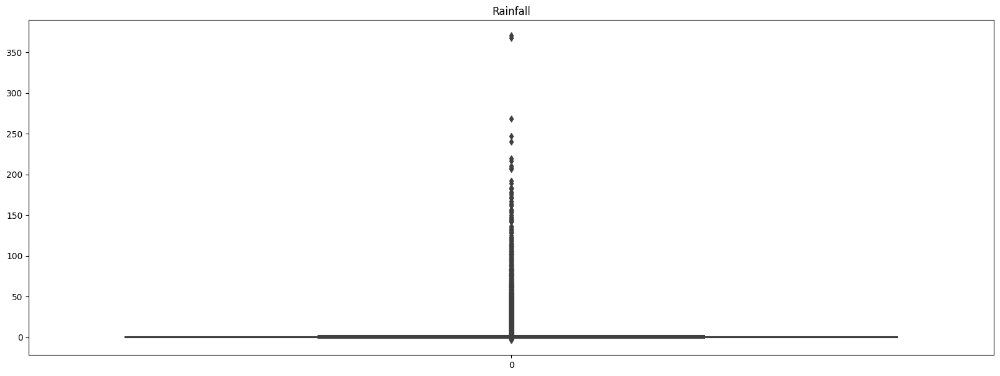

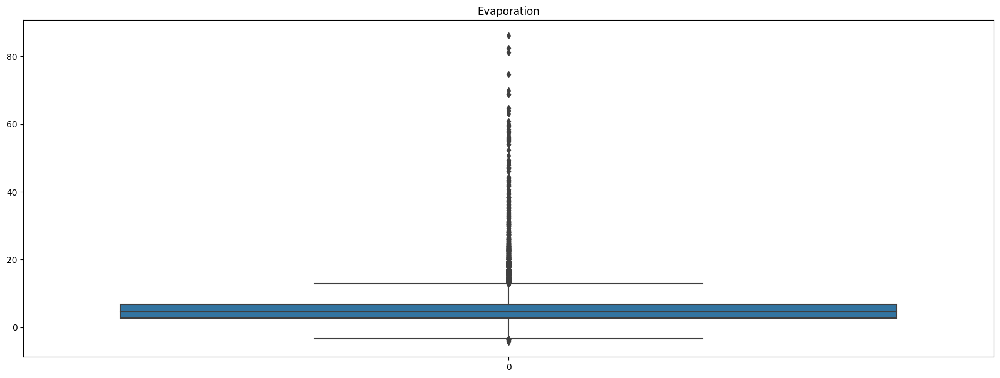

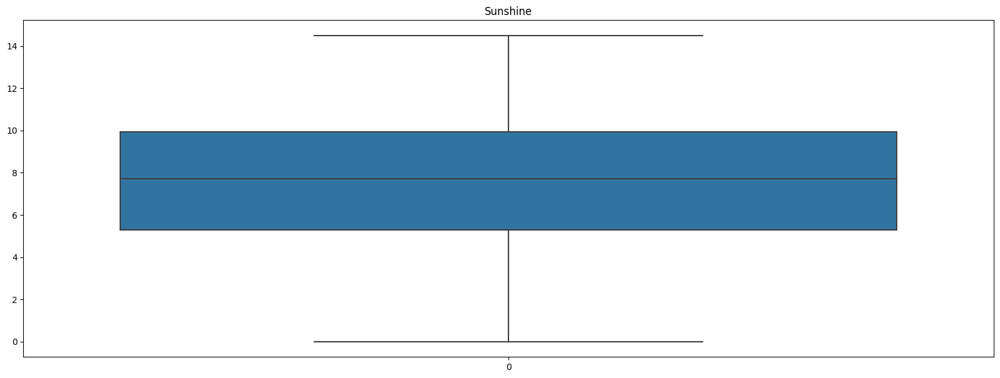

...

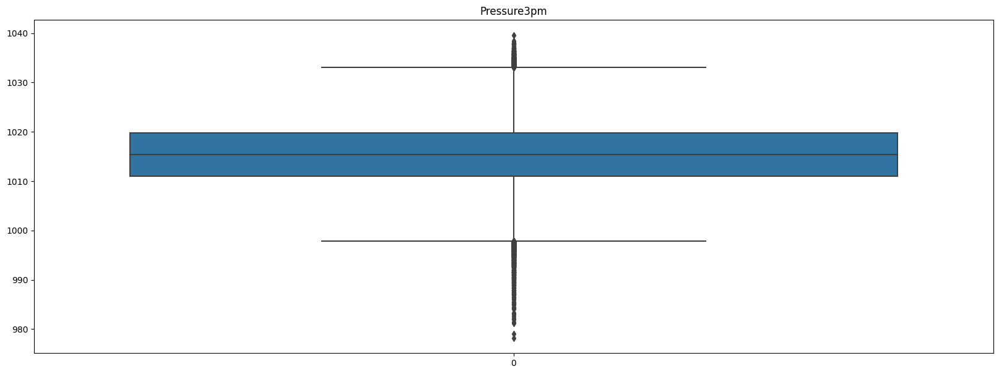

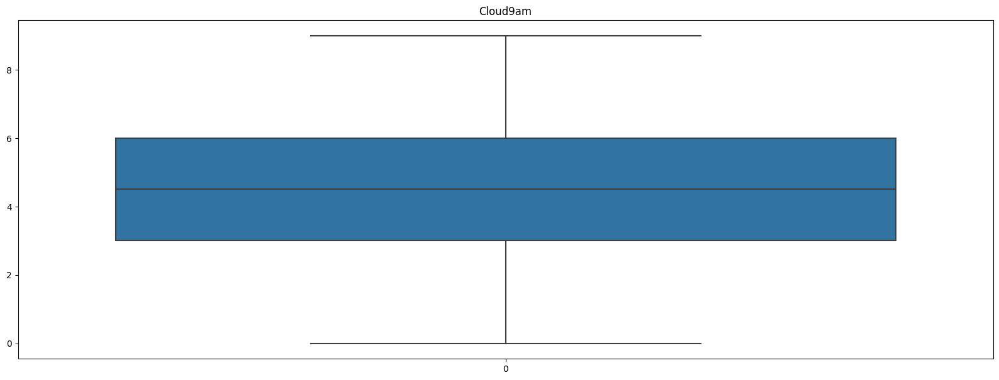

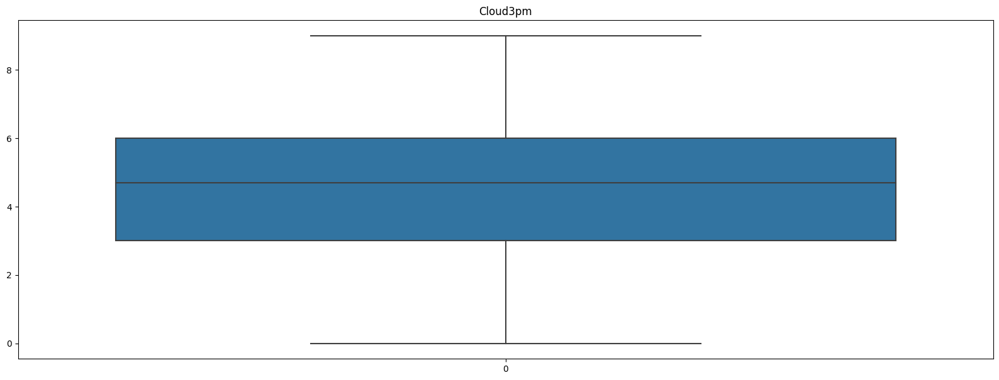

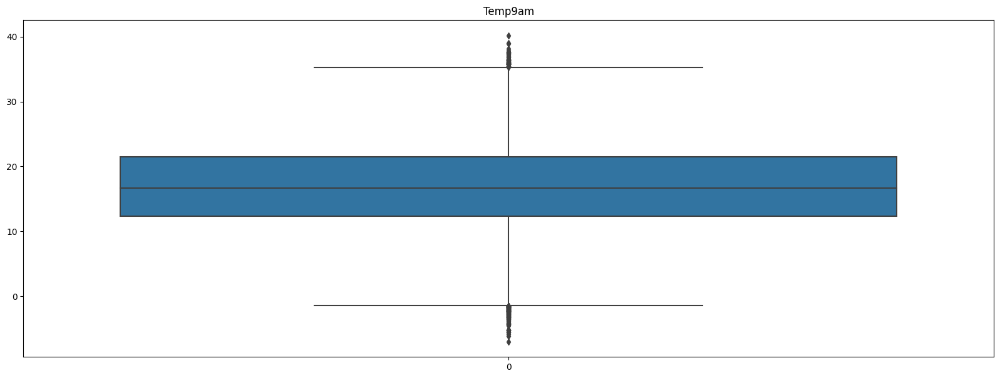

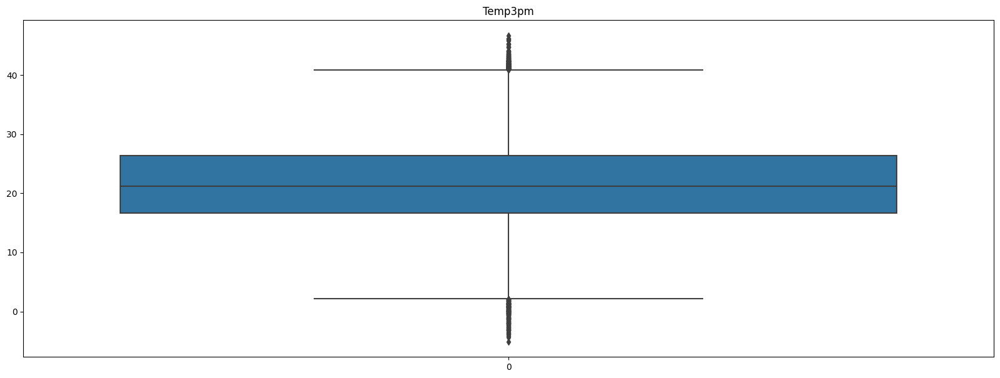

In [39]:
# Plotting distributions with respect to categories after encoding
for i in numeric_df.columns:
  plt.figure(figsize=(20,7))
  sns.boxplot(numeric_df[i])
  plt.title(i)
  plt.show()

In [40]:
# Heat Map of the correlation
plt.figure(figsize=(500,250))
sns.heatmap(final_train_df.corr(), annot=True, cmap='RdYlGn')

<Axes: >

## Test Train Split

Initially, data set needs to be split into features (X) and target (y).
The Test-Train Split is a commonly used procedure for evaluating the performance of a machine learning algorithm. It involves dividing a dataset into two parts: 
- #### Training Set
  
  It is used to train the machine learning model
- #### Test Set
  
  It is used to evaluate its performance.

In [41]:
from sklearn.model_selection import train_test_split # Library is required to split the data set into training set and test set

In [42]:
# Splitting the main DataFrame into X and y to perform regression
X = final_train_df.drop(columns=['RainTomorrow'], axis = 1).values
y = final_train_df['RainTomorrow'].values

In [43]:
X

array([[13.4, 22.9,  0.6, ...,  0. ,  1. ,  0. ],
       [ 7.4, 25.1,  0. , ...,  1. ,  1. ,  0. ],
       [17.5, 32.3,  1. , ...,  0. ,  1. ,  0. ],
       ...,
       [ 2.8, 23.4,  0. , ...,  0. ,  1. ,  0. ],
       [ 3.6, 25.3,  0. , ...,  0. ,  1. ,  0. ],
       [ 5.4, 26.9,  0. , ...,  0. ,  1. ,  0. ]])

In [44]:
y

array([0., 0., 0., ..., 0., 0., 0.])

In [45]:
# Splitting the Data set into 80% Training set and 20% Test set
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 0)

In [46]:
X_train

array([[19.5, 26.2,  0. , ...,  0. ,  1. ,  0. ],
       [ 6.9, 23.5,  0. , ...,  0. ,  1. ,  0. ],
       [ 5.7, 16.2,  0. , ...,  1. ,  1. ,  0. ],
       ...,
       [15.1, 20.1,  0. , ...,  0. ,  1. ,  0. ],
       [15.9, 39.7,  0. , ...,  0. ,  1. ,  0. ],
       [13.9, 25.8,  0.2, ...,  1. ,  1. ,  0. ]])

In [47]:
X_test

array([[12.1, 23.3,  0. , ...,  0. ,  1. ,  0. ],
       [10. , 20.3,  0. , ...,  0. ,  1. ,  0. ],
       [12.3, 21.4,  0. , ...,  0. ,  1. ,  0. ],
       ...,
       [ 6.6, 20.8,  0. , ...,  0. ,  1. ,  0. ],
       [14.9, 33.2,  0. , ...,  0. ,  1. ,  0. ],
       [ 6.1, 16.9,  2. , ...,  0. ,  0. ,  1. ]])

In [48]:
y_train

array([0., 0., 0., ..., 0., 0., 0.])

In [49]:
y_test

array([0., 0., 0., ..., 0., 0., 0.])

## Feature Scaling

Feature scaling is a technique in data preprocessing where the values of the features are transformed and standardized to have a similar range of values. This is done to bring all the features to the same level of magnitude, so that the model does not get swayed by the feature with a large magnitude. There are two common feature scaling techniques: 
- #### Min-Max Scaling

 Min-Max scaling scales the values between 0 and 1
- #### Standardization 

  It transforms the values to have a mean of 0 and a standard deviation of 1.

Refer: https://www.analyticsvidhya.com/blog/2021/05/feature-scaling-techniques-in-python-a-complete-guide/

In [50]:
from sklearn.preprocessing import MinMaxScaler # Library is required to perform feature scaling using MinMaxScaler

In [51]:
# Fit MinMaxScaler on the training data
scaler = MinMaxScaler()
scaler.fit(X_train)

# Transform both the Training and Test data
X_train = scaler.transform(X_train)
X_test = scaler.transform(X_test)

In [52]:
X_train

array([[0.66037736, 0.58045977, 0.00843613, ..., 0.        , 1.        ,
        0.        ],
       [0.36320755, 0.52873563, 0.00843613, ..., 0.        , 1.        ,
        0.        ],
       [0.33490566, 0.38888889, 0.00843613, ..., 1.        , 1.        ,
        0.        ],
       ...,
       [0.55660377, 0.46360153, 0.00843613, ..., 0.        , 1.        ,
        0.        ],
       [0.5754717 , 0.83908046, 0.00843613, ..., 0.        , 1.        ,
        0.        ],
       [0.52830189, 0.57279693, 0.00897067, ..., 1.        , 1.        ,
        0.        ]])

In [53]:
X_test

array([[0.48584906, 0.52490421, 0.00843613, ..., 0.        , 1.        ,
        0.        ],
       [0.43632075, 0.46743295, 0.00843613, ..., 0.        , 1.        ,
        0.        ],
       [0.49056604, 0.48850575, 0.00843613, ..., 0.        , 1.        ,
        0.        ],
       ...,
       [0.35613208, 0.47701149, 0.00843613, ..., 0.        , 1.        ,
        0.        ],
       [0.55188679, 0.71455939, 0.00843613, ..., 0.        , 1.        ,
        0.        ],
       [0.34433962, 0.40229885, 0.01378149, ..., 0.        , 0.        ,
        1.        ]])

### Visualizing the Training and Test Set

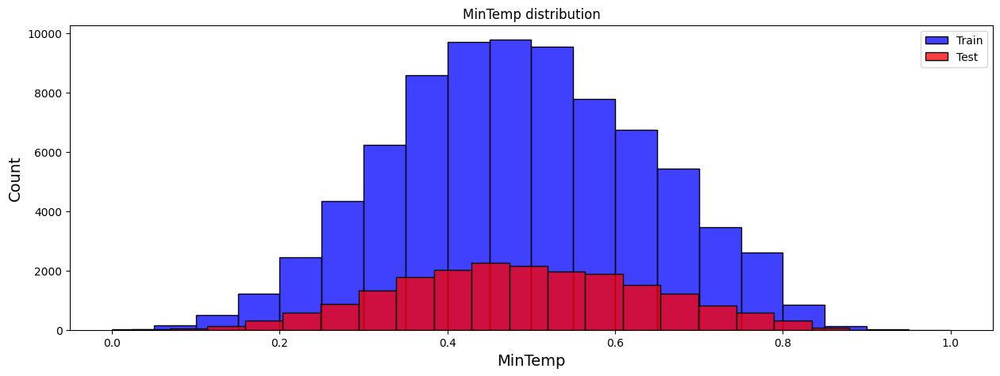

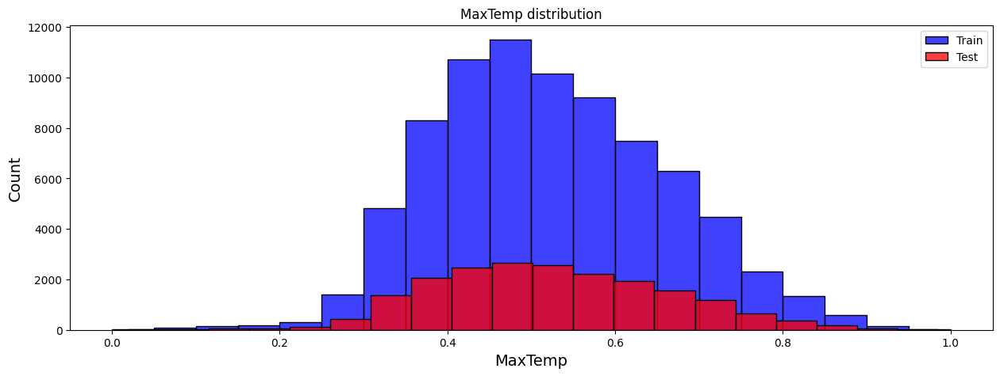

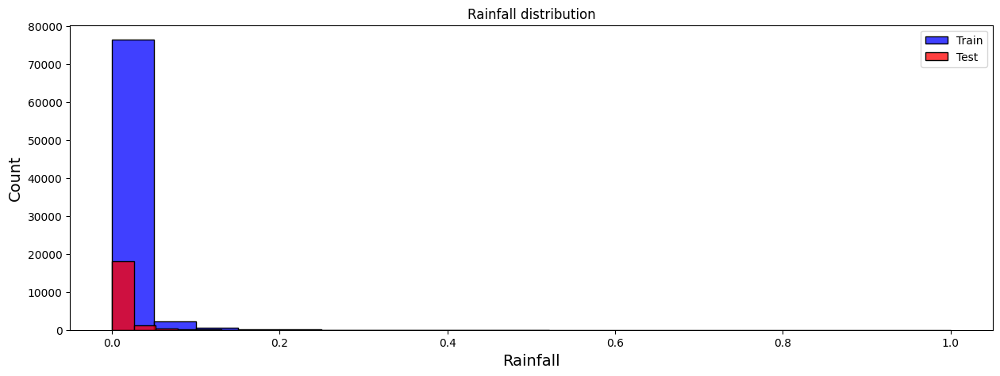

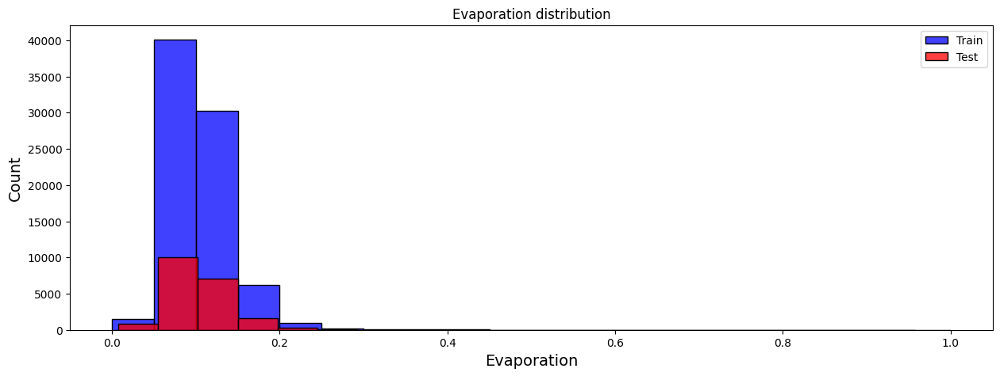

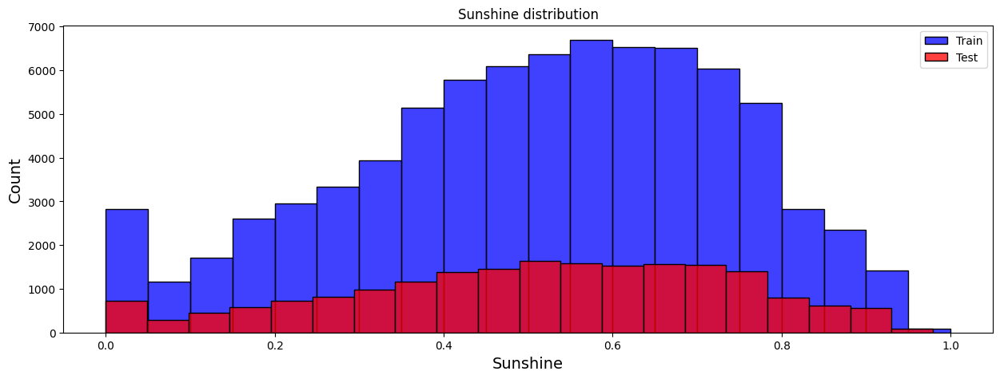

...

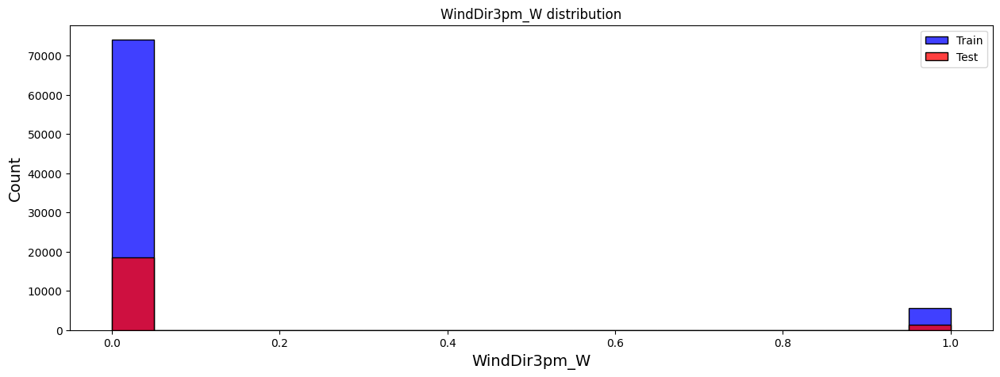

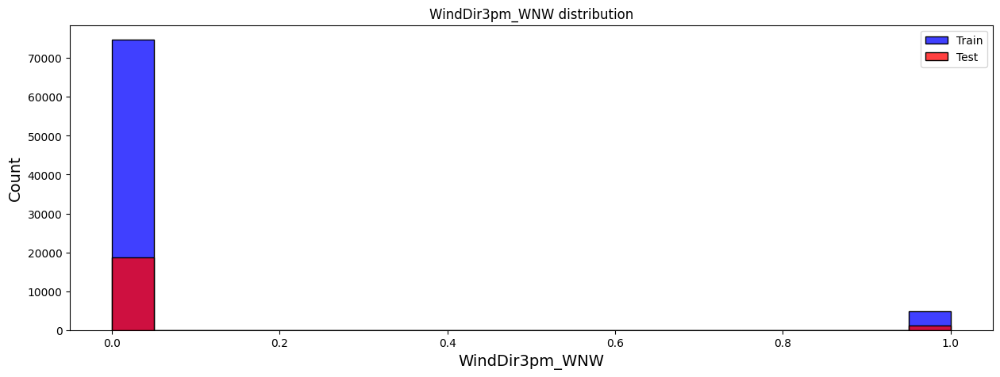

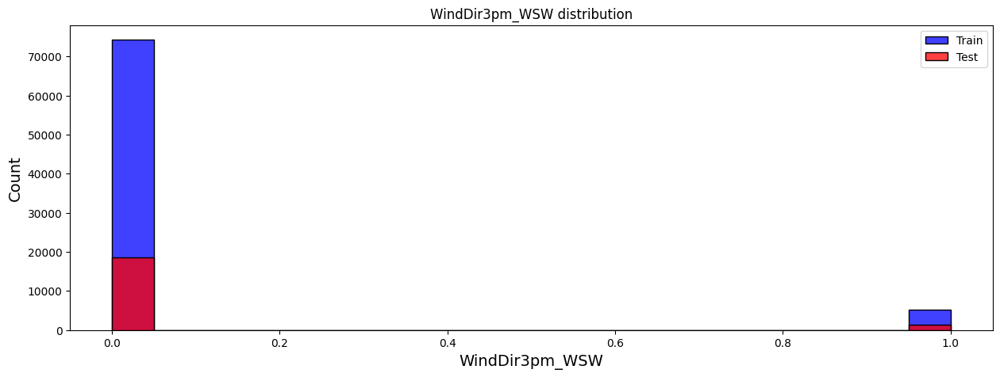

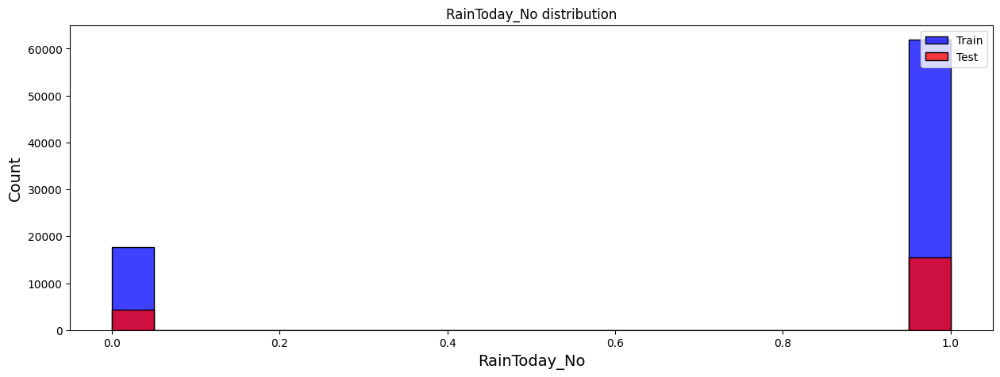

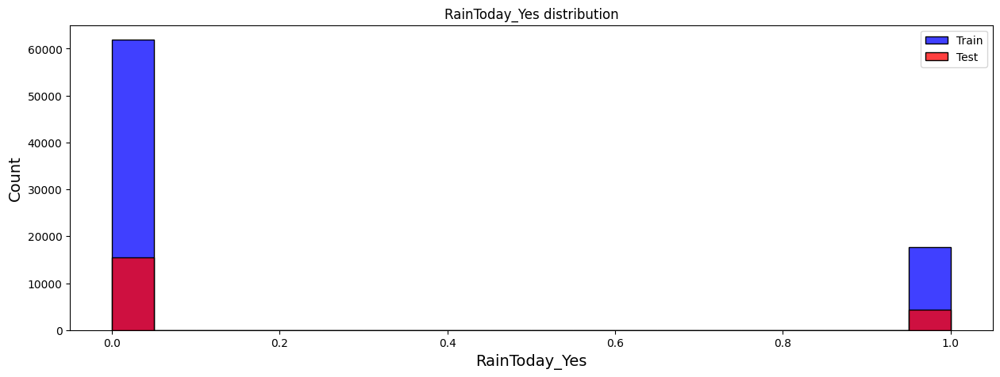

In [54]:
# Preparing DataFrames for Training and Test set for visualization
X_test_plot = pd.DataFrame(X_test, columns = final_train_df.drop(columns = ['RainTomorrow'], axis = 1).columns)
X_train_plot = pd.DataFrame(X_train, columns = final_train_df.drop(columns = ['RainTomorrow'], axis = 1).columns)

# Plotting the Training and Test set to visualize the data distribution
for c in X_test_plot.columns:
  plt.figure(figsize=(15,5))
  sns.histplot(X_train_plot[c], bins=20, color = 'blue', label = 'Train')
  sns.histplot(X_test_plot[c], bins=20, color = 'red', label = 'Test')
  plt.xlabel(c, size=14)
  plt.ylabel("Count", size=14)
  plt.legend(loc='upper right')
  plt.title("{} distribution".format(c))
  plt.show()

## Predictor Significance

Predictor significance refers to the importance of a predictor variable in explaining the variation in a response variable. It can be determined using various statistical methods, such as regression analysis, correlation, or feature importance algorithms, and is typically used in predictive modeling or hypothesis testing to identify the most influential variables affecting the response. 

A high predictor significance indicates that the predictor variable has a strong association with the response, while low significance suggests a weak or insignificant relationship.

Refer: https://www.geeksforgeeks.org/ordinary-least-squares-ols-using-statsmodels/

In [55]:
import statsmodels.api as sm # Library is required to calculate OLS for finding the P values to check the significant features

In [56]:
# Fitting the OLS model upon the Training set
model = sm.OLS(y, X).fit()

# Print out the statistics
model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.341
Model:                            OLS   Adj. R-squared:                  0.340
Method:                 Least Squares   F-statistic:                     466.8
Date:                Mon, 10 Apr 2023   Prob (F-statistic):               0.00
Time:                        00:25:19   Log-Likelihood:                -33531.
No. Observations:               99516   AIC:                         6.728e+04
Df Residuals:                   99405   BIC:                         6.834e+04
Df Model:                         110                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.0040      0.001     -7.011      0.000      -0.005      -0.003
x2             0.0018      0.001      1.988      0.047     2.5e-05       0.004
x3             0.0020      0.000     13.343      0.000       0.002       0.002
x4            -0.0002      0.000     -0.392      0.695      -0.001       0.001
x5            -0.0245      0.001    -37.160      0.000      -0.026      -0.023
x6             0.0076      0.000     56.254      0.000       0.007       0.008
x7            -0.0007      0.000     -3.616      0.000      -0.001      -0.000
x8            -0.0041      0.000    -22.103      0.000      -0.004      -0.004
x9            -0.0007      0.000     -5.592      0.000      -0.001      -0.000
x10            0.0083      0.000     61.024      0.000       0.008       0.009
x11           -0.0093      0.001    -12.814      0.000      -0.011      -0.008
x12           -0.0003      0.001     -0.455      0.649      -0.002       0.001
x13           -0.0032      0.001     -4.978      0.000      -0.004      -0.002
x14            0.0022      0.001      2.765      0.006       0.001       0.004
x15           -0.0046      0.001     -5.495      0.000      -0.006      -0.003
x16            0.0064      0.001      6.699      0.000       0.005       0.008
x17            0.3444      0.010     35.334      0.000       0.325       0.364
x18            0.2195      0.011     20.707      0.000       0.199       0.240
x19            0.2930      0.009     31.191      0.000       0.275       0.311
x20            0.3332      0.010     34.837      0.000       0.314       0.352
x21            0.2589      0.010     26.836      0.000       0.240       0.278
x22            0.1778      0.010     18.415      0.000       0.159       0.197
x23            0.2466      0.009     26.210      0.000       0.228       0.265
x24            0.3257      0.010     33.127      0.000       0.306       0.345
x25            0.2852      0.010     28.135      0.000       0.265       0.305
x26            0.2448      0.009     26.344      0.000       0.227       0.263
x27            0.3414      0.010     35.551      0.000       0.323       0.360
x28            0.2519      0.010     24.914      0.000       0.232       0.272
x29            0.2233      0.010     23.142      0.000       0.204       0.242
x30            0.2511      0.010     25.159      0.000       0.232       0.271
x31            0.2047      0.010     19.831      0.000       0.185       0.225
x32            0.1471      0.009     15.835      0.000       0.129       0.165
x33            0.2865      0.012     23.304      0.000       0.262       0.311
x34            0.1702      0.010     17.711      0.000       0.151       0.189
x35            0.2459      0.010     23.654      0.000       0.225       0.266
x36            0.1991      0.010     20.423      0.000       0.180       0.218
x3

## Logistic Regression

Logistic Regression is a type of supervised learning, which is used for solving binary classification problems. In binary classification, the goal is to predict one of two possible outcomes, given a set of inputs. The logistic regression model uses a logistic function to predict the probability of the positive class and maps it to binary predictions.

Refer: https://www.youtube.com/watch?v=yIYKR4sgzI8

In [57]:
# Fitting the Logistic Regression to the Training Set
from sklearn.linear_model import LogisticRegression # Library is required to perform Logistic Regression
from sklearn.metrics import classification_report # Library is required to build a text report showing the main classification metrics

In [58]:
# Train the Logistic Regression Model
regressor = LogisticRegression()
regressor.fit(X_train, y_train)

LogisticRegression()

In [59]:
# Predicting the Test set Results using the Logistic Regression Model
y_pred = regressor.predict(X_test)
y_pred

array([0., 0., 0., ..., 0., 0., 0.])

In [60]:
# Calculating Train and Test Score
train_score = regressor.score(X_train , y_train)
test_score = regressor.score(X_test , y_test)
print("Train Score: ", round(train_score, 5))
print("Test Score: ", round(test_score,5))

Train Score:  0.84771
Test Score:  0.84857


In [61]:
# Assessing the Prediction Values
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

# Print the results
print("Mean Absolute Error:", mae)
print("Mean Squared Error:", mse)
print("R-Squared:", r2)

Mean Absolute Error: 0.15142684887459806
Mean Squared Error: 0.15142684887459806
R-Squared: 0.12961353464445557


### Confusion Matrix

A confusion matrix is a table used to evaluate the performance of a classification model. It is used to compare the predicted class to the actual class for each instance in the test dataset. The matrix provides four values for each prediction made by the model: true positive (TP), false positive (FP), true negative (TN), and false negative (FN).

Refer: https://towardsdatascience.com/understanding-confusion-matrix-a9ad42dcfd62

In [62]:
from sklearn.metrics import confusion_matrix # Library is required to plot a Confusion Matrix

In [63]:
# Generating a Confusion Matrix using the actual and predicted values
cm = confusion_matrix(y_test, y_pred)
cm

array([[14567,   873],
       [ 2141,  2323]])

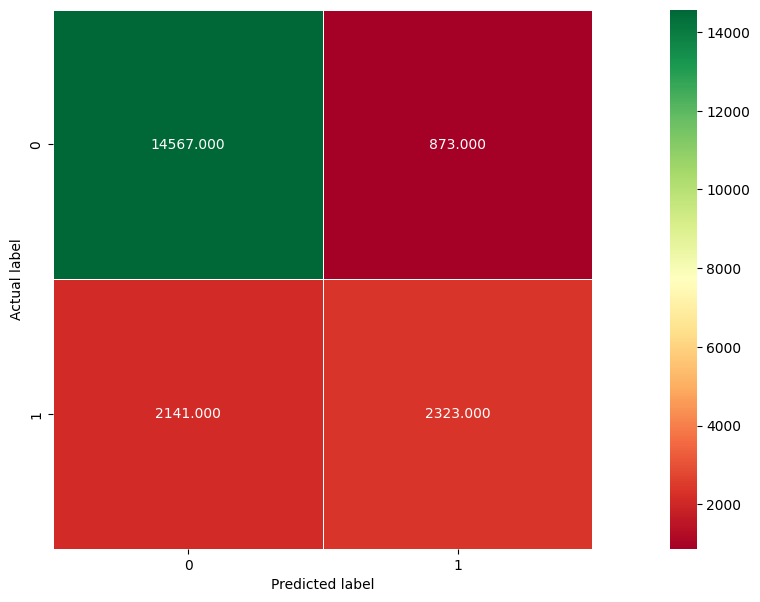

In [64]:
# Plotting the Confusion Matrix
plt.figure(figsize=(20,7))
sns.heatmap(cm, annot=True, fmt=".3f", linewidths=.5, square = True, cmap = 'RdYlGn');
plt.ylabel('Actual label');
plt.xlabel('Predicted label');

### Classification Report
A classification report is a performance evaluation metric in machine learning that provides a summary of the accuracy of a classifier on a test set. It provides several key metrics like:

- #### Precision

  Precision is the ratio of correctly predicted positive observations to the total predicted positive observations.

- #### Recall

  Recall is the ratio of correctly predicted positive observations to the all observations in actual class.

- #### F1-Score
  
  F1-Score is the Harmonic Mean between precision and recall. The range for F1-Score is [0, 1].

- #### Support 
  
  Support is the number of observations for each class.

- #### Accuracy

  Accuracy is the ratio of correctly predicted observation to the total observations.

- #### Macro Average 

  The average of the unweighted mean per label.

- #### Weighted Average

  The average weighted by the number of samples in each class.

Refer: https://www.statology.org/sklearn-classification-report/

In [65]:
# Generating a Classification Report based on the Actual and Predicted values
report = pd.DataFrame(classification_report(y_test, y_pred, output_dict = True))
report

,0.0,1.0,accuracy,macro avg,weighted avg
precision,0.871858,0.726846,0.848573,0.799352,0.839335
recall,0.943459,0.520385,0.848573,0.731922,0.848573
f1-score,0.906246,0.606527,0.848573,0.756387,0.839026
support,15440.000000,4464.000000,0.848573,19904.000000,19904.000000


### Interpreting Regressor Coefficients

In [66]:
# Sorting the features and their coefficients based on the magnitude of the coefficients
coef_df = pd.DataFrame({'Feature': X_train_plot.columns, 'Coefficient': regressor.coef_.flatten()})
coef_df['Abs_Coefficient'] = abs(coef_df['Coefficient'])
coef_df = coef_df.sort_values(by='Abs_Coefficient', ascending=False)
coef_df = coef_df[['Feature', 'Coefficient']]
print(coef_df)

                   Feature  Coefficient
5            WindGustSpeed     6.702537
9              Humidity3pm     5.228086
10             Pressure9am    -3.394493
2                 Rainfall     2.921495
15                 Temp3pm     2.283907
..                     ...          ...
113           WindDir3pm_E    -0.009757
38   Location_MountGambier    -0.005784
49       Location_Portland    -0.005207
110           WindDir9am_W     0.005183
112         WindDir9am_WSW     0.000039

[131 rows x 2 columns]


- A negative coefficient for a feature indicates that an increase in the feature value is associated with a decrease in the dependent variable, while a positive coefficient indicates the opposite. 
- The magnitude of the coefficient indicates the strength of the relationship between the feature and the dependent variable.
- Pressure3PM has the highest negative magnitude and Humidity3PM has the highest positive magnitude of coefficients. 

## Permutation Importance

Permutation importance is a technique used to evaluate the feature importance in a predictive model. It measures the decrease in model performance after a feature is randomly permuted. The idea behind this method is that if a feature is truly important for a model's predictions, then permuting the values of that feature should greatly decrease the accuracy of the model.

Refer: https://scikit-learn.org/stable/modules/permutation_importance.html

In [67]:
!pip install eli5
import eli5
from eli5.sklearn import PermutationImportance # Library is required to calculate permutation importance for understanding important features

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 216.2/216.2 KB 5.4 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for eli5: filename=eli5-0.13.0-py2.py3-none-any.whl size=107747 sha256=dd5fc75b586182643dbfcb4c60569d664eec4f72700035c4c8bdbe91980a9915
  Stored in directory: /root/.cache/pip/wheels/7b/26/a5/8460416695a992a2966b41caa5338e5e7fcea98c9d032d055c
Successfully built eli5


In [68]:
# Initialize the Permutation Importance model
perm = PermutationImportance(regressor, random_state=1).fit(X_test, y_test)

# Show the feature importances computed by the PermutationImportance model
eli5.show_weights(perm, feature_names = final_train_df.drop(columns=['RainTomorrow'], axis = 1).columns.tolist())

Weight,Feature
0.0637 ± 0.0026,Humidity3pm
0.0248 ± 0.0038,WindGustSpeed
0.0130 ± 0.0017,Sunshine
0.0083 ± 0.0017,RainToday_No
0.0072 ± 0.0033,Pressure9am
0.0025 ± 0.0025,Temp3pm
0.0019 ± 0.0016,RainToday_Yes
0.0019 ± 0.0003,Location_Wollongong
0.0012 ± 0.0008,MaxTemp
0.0011 ± 0.0013,WindSpeed3pm


## Outliers Detection and Removal

Outliers are observations in a data set that are significantly different from the majority of other observations. They can have a major impact on statistical analyses and may lead to misleading results if not handled appropriately.

In some cases, they may represent legitimate values that need to be analyzed and understood in context, while in other cases, they may need to be removed or excluded from the analysis.

Refer: https://www.geeksforgeeks.org/machine-learning-outlier/

In [69]:
# Detecting outliers for each numeric variables
for i in numeric_df.columns:
  # Initialize the outliers list and set the threshold
  outliers = []
  threshold = 3 

  # Compute the mean and standard deviation of the current column
  mean=np.mean(numeric_df[i])
  std=np.std(numeric_df[i])

  for j in numeric_df[i]:
    # Compute the z-score of the current value
    z_score=(j-mean)/std

    # Check if the absolute z-score is greater than the threshold
    if np.abs(z_score)> threshold:
      outliers.append(j)
  # Print the columns and their outliers
  print(i)
  print(outliers, '\n')

MinTemp
[-8.0, -7.0, -7.0, -7.0, -8.5, -8.0, -7.1, -7.6, -7.5, -8.2, -7.2, -7.8, -7.0, -7.3, -7.0, 31.9, 33.9, 31.4, 31.4] 

MaxTemp
[44.8, 45.8, 46.4, 46.0, 45.2, 45.7, 46.6, 47.3, 47.3, 46.5, 44.9, 45.1, 46.9, 46.4, 45.3, 45.8, 45.5, -1.7, 0.0, 0.0, 0.1, -0.1, -2.2, -0.6, 0.6, 0.4, -0.7, -1.8, -0.2, 0.1, -1.3, 0.1, -0.6, -0.6, 1.6, 0.3, 1.2, 1.0, 0.5, 0.2, 0.9, -0.3, 0.6, -2.5, 1.4, 1.8, 1.0, -2.7, -1.0, 0.5, 1.6, -1.4, 0.1, -2.0, -1.3, 1.7, -0.9, -2.1, -1.5, -3.1, 0.9, 0.1, -0.8, 0.3, 1.0, -0.6, 1.0, 1.7, 1.1, -2.1, 1.4, -1.5, -1.2, -2.0, -0.1, -1.1, -1.5, 1.7, 0.2, 0.1, -0.3, 1.5, 0.0, 0.9, 1.7, 0.3, 0.6, 0.1, 1.8, 0.6, 0.0, -1.0, 0.0, 0.3, 0.8, 0.2, 1.6, 1.3, 1.3, -2.3, 1.0, -1.5, -1.5, -1.1, 0.5, 1.4, 1.2, 1.8, 1.1, 0.6, -2.2, -0.6, -3.7, -2.9, 0.3, -0.8, 0.5, 0.1, -0.4, 1.7, -3.8, 0.0, 1.6, 1.2, 0.9, -0.9, -1.7, -1.9, 0.9, -0.5, 1.2, -2.1, -0.3, 0.7, 1.3, 0.8, -0.3, -4.1, -1.4, 1.4, -0.7, 1.7, 1.0, -1.3, 1.5, 0.8, 1.0, -1.4, -0.2, -0.7, 0.0, -0.2, 1.6, -0.2, -0.2, -3.2, 0.0, -1.

In [70]:
# Function to detect and remove outliers
def detect_and_remove_outliers(numeric_df):
    for column_name in numeric_df.columns:

        # Initialize the outliers list and set the threshold
        outliers = []
        threshold = 3 # 3 Standard Deviations from the mean
        column = numeric_df[column_name]

        # Compute the mean and standard deviation of the current column
        mean = np.mean(column)
        std = np.std(column)

        for value in column:
          # Compute the z-score of the current value
            z_score = (value - mean) / std
            # Check if the absolute z-score is greater than the threshold
            if np.abs(z_score) > threshold:
                outliers.append(value)

        # Remove the outliers from the numeric dataframe
        numeric_df = numeric_df[~numeric_df[column_name].isin(outliers)]
    return numeric_df

# Apply the function to the numeric dataframe
df_without_outliers = detect_and_remove_outliers(numeric_df)
df_without_outliers.head()

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm
0,13.4,22.9,0.6,5.265185,9.270800,44.0,20.0,24.0,71.0,22.0,1007.7,1007.1,8.000000,4.839468,16.9,21.8
1,7.4,25.1,0.0,7.506115,10.041269,44.0,4.0,22.0,44.0,25.0,1010.6,1007.8,4.511880,3.495782,17.2,24.3
2,17.5,32.3,1.0,6.525070,6.195270,41.0,7.0,20.0,82.0,33.0,1010.8,1006.0,7.000000,8.000000,17.8,29.7
3,14.6,29.7,0.2,8.142001,10.227973,56.0,19.0,24.0,55.0,23.0,1009.2,1005.4,4.511880,3.429891,20.6,28.9
4,7.7,26.7,0.0,7.366911,10.577251,35.0,6.0,17.0,48.0,19.0,1013.4,1010.1,4.696809,3.339416,16.3,25.5


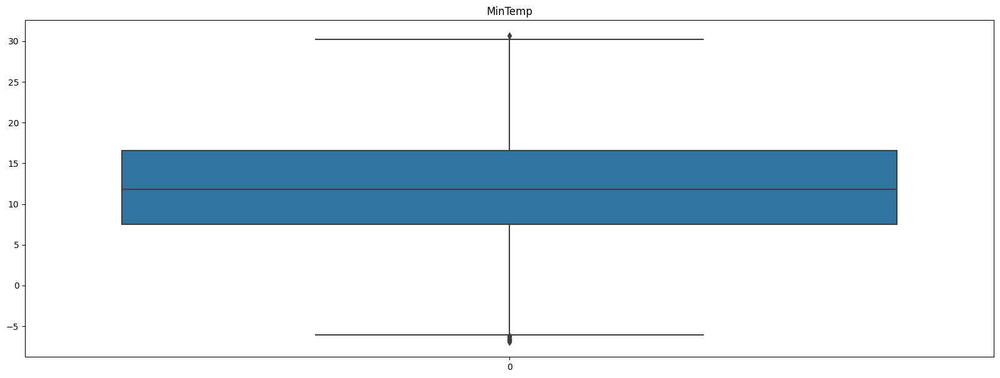

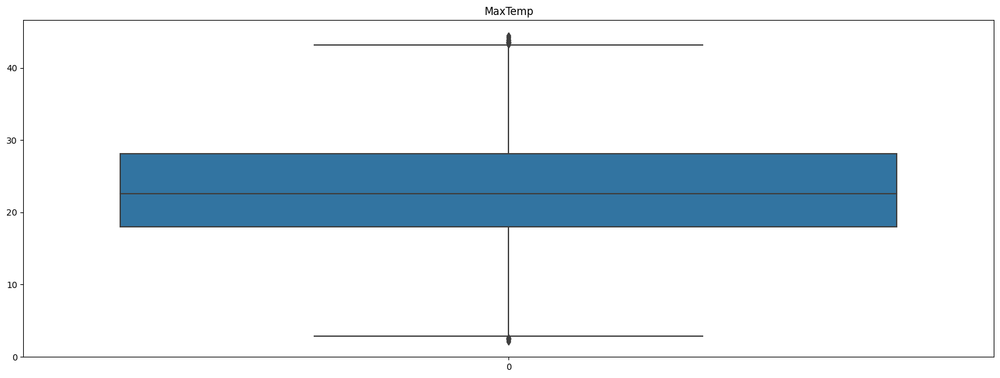

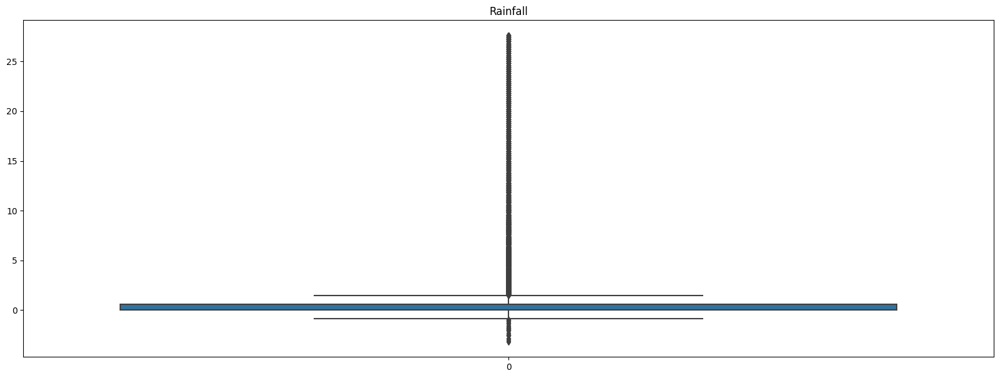

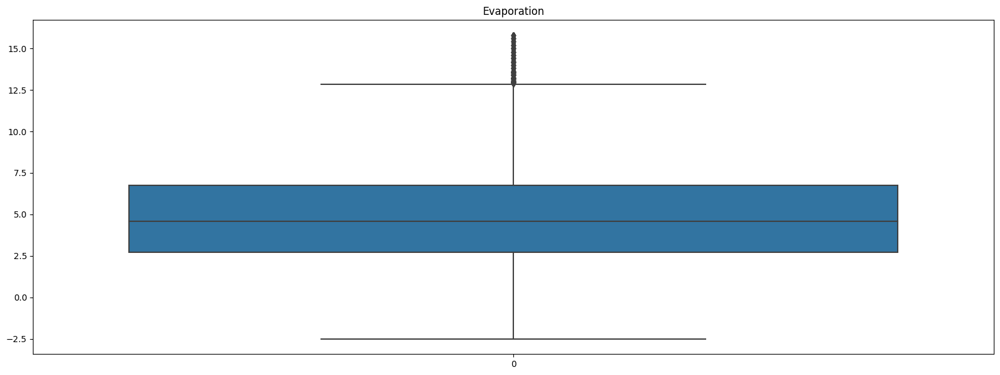

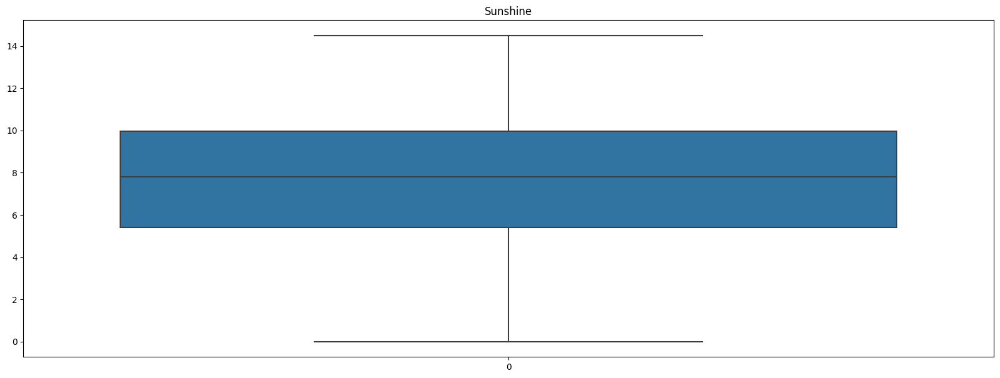

...

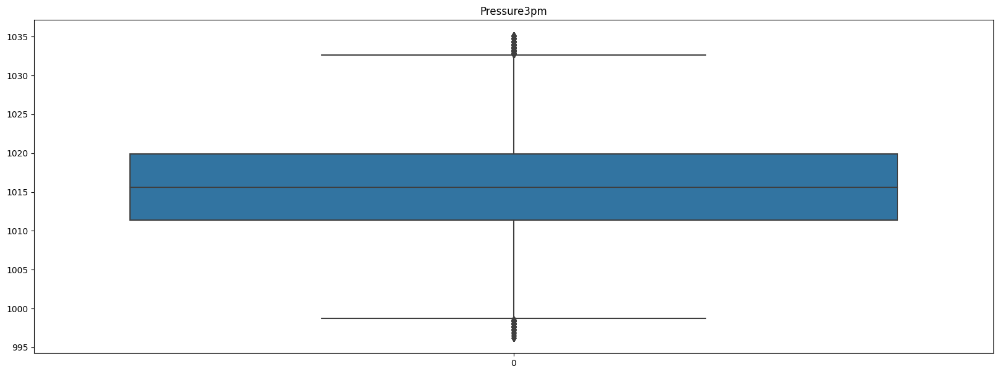

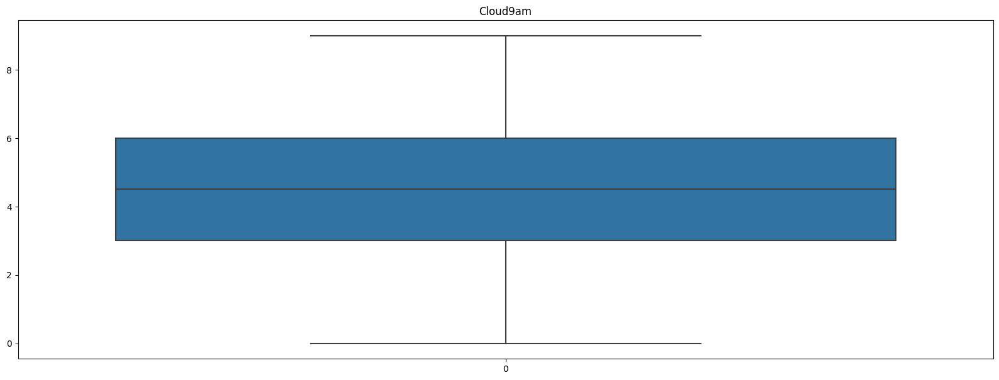

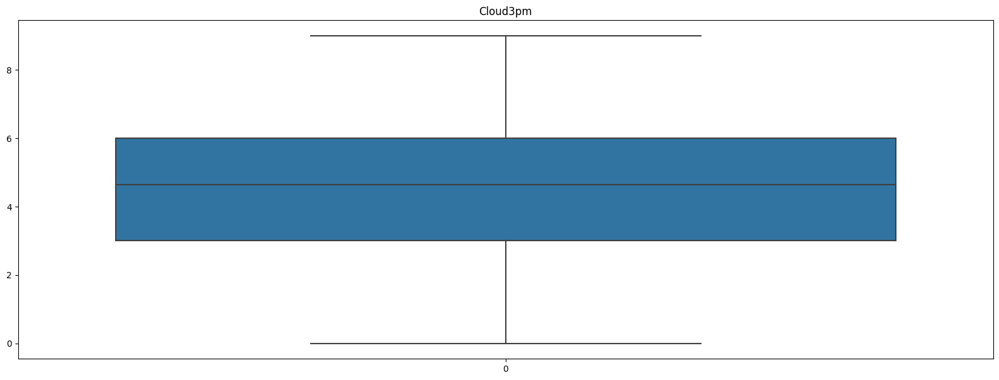

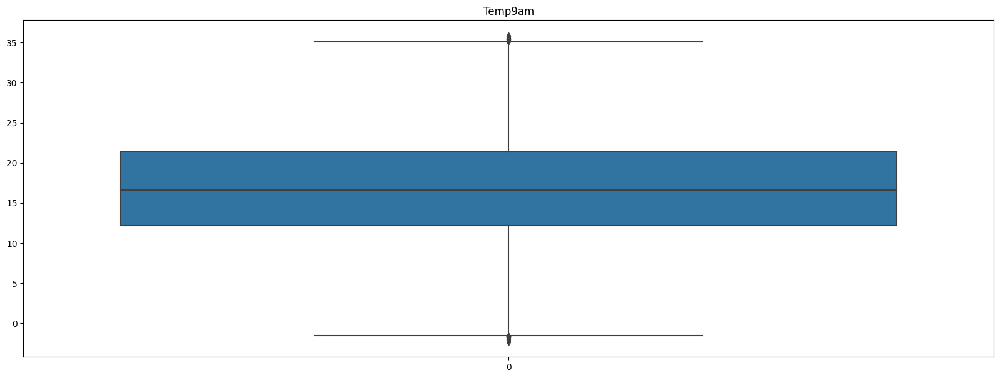

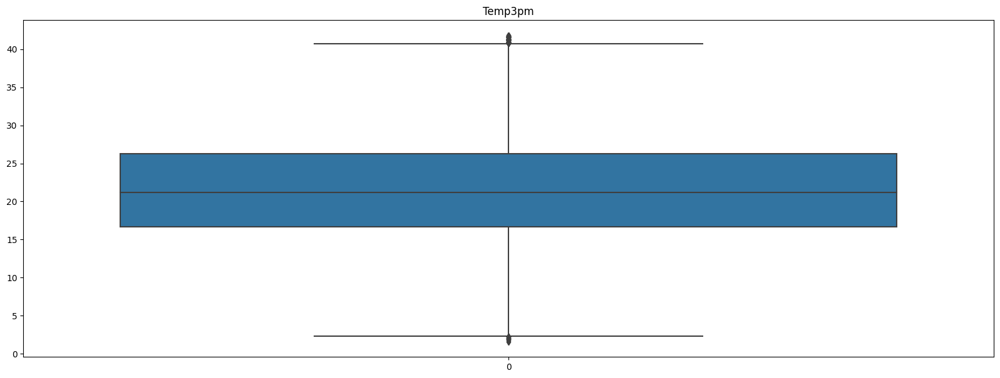

In [71]:
# Plotting distributions with respect to categories after removing outliers
for column_name in df_without_outliers.columns:
  plt.figure(figsize=(20,7))
  sns.boxplot(df_without_outliers[column_name])
  plt.title(column_name)
  plt.show()

In [72]:
# Remove the Outliers from the main DataFrame
col = ['MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine', 'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am', 'Temp3pm']
final_train_df[col] = df_without_outliers[col]
final_train_df.dropna(inplace = True)

### Performing Regression after removing Outliers

In [73]:
# Split the data into features (X) and target (y)
X_out = final_train_df.drop(columns = ['RainTomorrow'], axis = 1).values
y_out = final_train_df['RainTomorrow'].values

In [74]:
X_out

array([[13.4, 22.9,  0.6, ...,  0. ,  1. ,  0. ],
       [ 7.4, 25.1,  0. , ...,  1. ,  1. ,  0. ],
       [17.5, 32.3,  1. , ...,  0. ,  1. ,  0. ],
       ...,
       [ 2.8, 23.4,  0. , ...,  0. ,  1. ,  0. ],
       [ 3.6, 25.3,  0. , ...,  0. ,  1. ,  0. ],
       [ 5.4, 26.9,  0. , ...,  0. ,  1. ,  0. ]])

In [75]:
y_out

array([0., 0., 0., ..., 0., 0., 0.])

In [76]:
# Splitting the Data set into 80% Training set and 20% Test set
X_train_out, X_test_out, y_train_out, y_test_out = train_test_split(X, y, test_size = 0.2, random_state = 0)

In [77]:
X_train_out

array([[19.5, 26.2,  0. , ...,  0. ,  1. ,  0. ],
       [ 6.9, 23.5,  0. , ...,  0. ,  1. ,  0. ],
       [ 5.7, 16.2,  0. , ...,  1. ,  1. ,  0. ],
       ...,
       [15.1, 20.1,  0. , ...,  0. ,  1. ,  0. ],
       [15.9, 39.7,  0. , ...,  0. ,  1. ,  0. ],
       [13.9, 25.8,  0.2, ...,  1. ,  1. ,  0. ]])

In [78]:
X_test_out

array([[12.1, 23.3,  0. , ...,  0. ,  1. ,  0. ],
       [10. , 20.3,  0. , ...,  0. ,  1. ,  0. ],
       [12.3, 21.4,  0. , ...,  0. ,  1. ,  0. ],
       ...,
       [ 6.6, 20.8,  0. , ...,  0. ,  1. ,  0. ],
       [14.9, 33.2,  0. , ...,  0. ,  1. ,  0. ],
       [ 6.1, 16.9,  2. , ...,  0. ,  0. ,  1. ]])

In [79]:
y_train_out

array([0., 0., 0., ..., 0., 0., 0.])

In [80]:
y_test_out

array([0., 0., 0., ..., 0., 0., 0.])

In [81]:
# Fit MinMaxScaler on the training data
scaler = MinMaxScaler()
scaler.fit(X_train_out)

# Transform both the training and test data
X_train_out = scaler.transform(X_train_out)
X_test_out = scaler.transform(X_test_out)

In [82]:
X_train_out

array([[0.66037736, 0.58045977, 0.00843613, ..., 0.        , 1.        ,
        0.        ],
       [0.36320755, 0.52873563, 0.00843613, ..., 0.        , 1.        ,
        0.        ],
       [0.33490566, 0.38888889, 0.00843613, ..., 1.        , 1.        ,
        0.        ],
       ...,
       [0.55660377, 0.46360153, 0.00843613, ..., 0.        , 1.        ,
        0.        ],
       [0.5754717 , 0.83908046, 0.00843613, ..., 0.        , 1.        ,
        0.        ],
       [0.52830189, 0.57279693, 0.00897067, ..., 1.        , 1.        ,
        0.        ]])

In [83]:
X_test_out

array([[0.48584906, 0.52490421, 0.00843613, ..., 0.        , 1.        ,
        0.        ],
       [0.43632075, 0.46743295, 0.00843613, ..., 0.        , 1.        ,
        0.        ],
       [0.49056604, 0.48850575, 0.00843613, ..., 0.        , 1.        ,
        0.        ],
       ...,
       [0.35613208, 0.47701149, 0.00843613, ..., 0.        , 1.        ,
        0.        ],
       [0.55188679, 0.71455939, 0.00843613, ..., 0.        , 1.        ,
        0.        ],
       [0.34433962, 0.40229885, 0.01378149, ..., 0.        , 0.        ,
        1.        ]])

In [84]:
# Train the logistic regression model
logistic_regression = LogisticRegression()
logistic_regression.fit(X_train_out, y_train_out)

# Use the trained model to make predictions
y_pred_out = logistic_regression.predict(X_test_out)

In [85]:
y_pred_out

array([0., 0., 0., ..., 0., 0., 0.])

In [86]:
# Calculating Train and Test Score
train_score = regressor.score(X_train_out, y_train_out)
test_score = regressor.score(X_test_out, y_test_out)
print("Train Score: ", round(train_score, 5))
print("Test Score: ", round(test_score,5))

Train Score:  0.84771
Test Score:  0.84857


In [87]:
# Assessing the Prediction values
mae = mean_absolute_error(y_test_out, y_pred_out)
mse = mean_squared_error(y_test_out, y_pred_out)
r2 = r2_score(y_test_out, y_pred_out)

# Print the results
print("Mean Absolute Error:", mae)
print("Mean Squared Error:", mse)
print("R-Squared:", r2)

Mean Absolute Error: 0.15142684887459806
Mean Squared Error: 0.15142684887459806
R-Squared: 0.12961353464445557


In [88]:
# Generating a Confusion Matrix using the actual and predicted values
cm = confusion_matrix(y_test_out, y_pred_out)
cm

array([[14567,   873],
       [ 2141,  2323]])

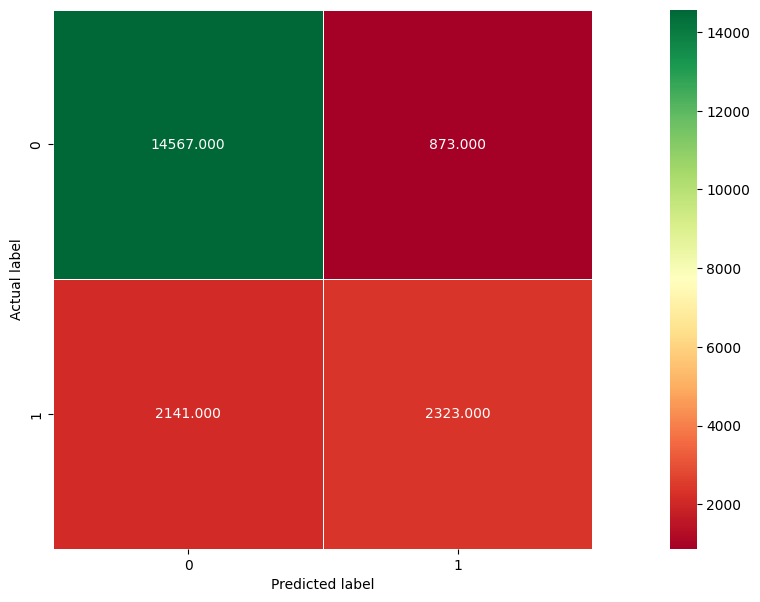

In [89]:
# Plotting the Confusion Matrix
plt.figure(figsize=(20,7))
sns.heatmap(cm, annot=True, fmt=".3f", linewidths=.5, square = True, cmap = 'RdYlGn');
plt.ylabel('Actual label');
plt.xlabel('Predicted label');

In [90]:
# Generating a Classification Report based on the Actual and Predicted values
report = pd.DataFrame(classification_report(y_test_out, y_pred_out, output_dict = True))
report

,0.0,1.0,accuracy,macro avg,weighted avg
precision,0.871858,0.726846,0.848573,0.799352,0.839335
recall,0.943459,0.520385,0.848573,0.731922,0.848573
f1-score,0.906246,0.606527,0.848573,0.756387,0.839026
support,15440.000000,4464.000000,0.848573,19904.000000,19904.000000


## Feature Importance of Numeric Variables

In [91]:
# Correlation of numeric variables
numeric_df.corr()

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm
MinTemp,1.000000,0.735594,0.102832,0.513117,0.062123,0.182422,0.177524,0.170912,-0.241835,-0.006335,-0.468532,-0.476538,0.053552,0.010755,0.902296,0.712486
MaxTemp,0.735594,1.000000,-0.074246,0.682421,0.471671,0.076528,0.017804,0.048406,-0.510573,-0.515405,-0.353722,-0.446148,-0.231897,-0.294649,0.885539,0.979700
Rainfall,0.102832,-0.074246,1.000000,-0.086206,-0.227973,0.128258,0.086738,0.060389,0.222065,0.253884,-0.160197,-0.115583,0.169629,0.172938,0.010267,-0.080085
Evaporation,0.513117,0.682421,-0.086206,1.000000,0.408710,0.203972,0.188131,0.163045,-0.592724,-0.482068,-0.287359,-0.326933,-0.192759,-0.250876,0.630492,0.673305
Sunshine,0.062123,0.471671,-0.227973,0.408710,1.000000,-0.024064,-0.003447,0.022148,-0.516481,-0.718866,0.021960,-0.045736,-0.586298,-0.739270,0.272880,0.499339
WindGustSpeed,0.182422,0.076528,0.128258,0.203972,-0.024064,1.000000,0.578022,0.657417,-0.212816,-0.025380,-0.444357,-0.397803,0.050481,0.077371,0.156126,0.039016
WindSpeed9am,0.177524,0.017804,0.086738,0.188131,-0.003447,0.578022,1.000000,0.522140,-0.271811,-0.027875,-0.214900,-0.160405,0.014925,0.040667,0.130904,0.004242
WindSpeed3pm,0.170912,0.048406,0.060389,0.163045,0.022148,0.657417,0.522140,1.000000,-0.146579,0.017821,-0.284390,-0.242695,0.042528,0.025793,0.160210,0.024478
Humidity9am,-0.241835,-0.510573,0.222065,-0.592724,-0.516481,-0.212816,-0.271811,-0.146579,1.000000,0.663621,0.150516,0.199967,0.354318,0.364090,-0.477904,-0.500312
Humidity3pm,-0.006335,-0.515405,0.253884,-0.482068,-0.718866,-0.025380,-0.027875,0.017821,0.663621,1.000000,-0.009058,0.077422,0.409212,0.546782,-0.232806,-0.561516


<Axes: >

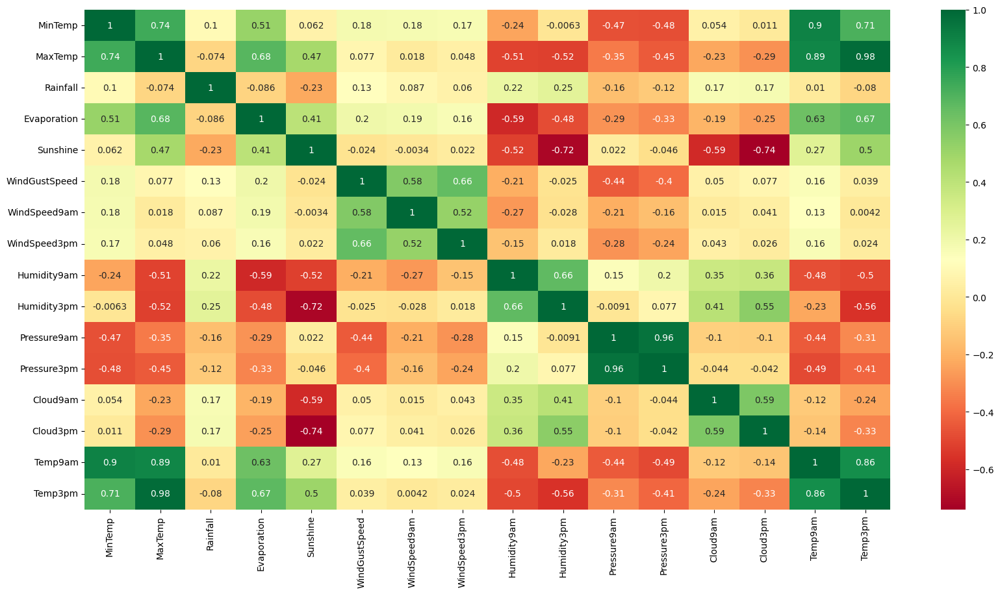

In [92]:
# Heat Map of Numeric Variables
plt.figure(figsize = (20,10))
sns.heatmap(numeric_df.corr() , annot = True, cmap = "RdYlGn")

<Axes: >

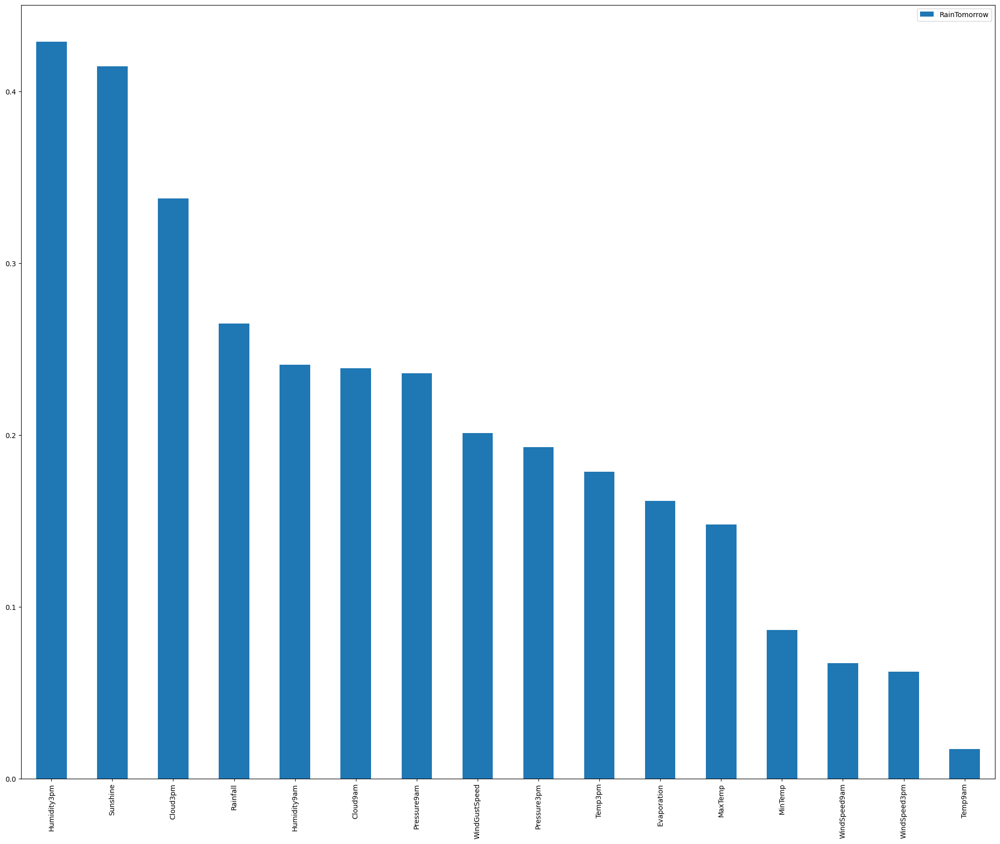

In [93]:
# Ranking numeric variables based on correlation
new_df = final_train_df[['MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine', 'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am', 'Temp3pm', 'RainTomorrow']] 
pd.DataFrame(abs(new_df.corr()['RainTomorrow'].drop('RainTomorrow')).sort_values(ascending=False)).plot.bar()

## Analyzing Model Interpretability Methods

### SHAP Analysis
SHAP (SHapley Additive exPlanations) Analysis is a method used to explain the output of any machine learning model. It is a game-theoretic approach that provides a way to attribute the prediction of a model to the input features of the data.

SHAP Analysis aims to identify the contribution of each feature to the final prediction by calculating the Shapley values, which are the average marginal contributions of each feature over all possible subsets of the features. Shapley values provide a fair way to distribute the credit of the prediction among the input features.

Refer: https://towardsdatascience.com/shap-a-reliable-way-to-analyze-your-model-interpretability-874294d30af6

### Logistic Regression Model SHAP Analysis

In [94]:
# Generating new DataFrames for train and test set for further use
X_train_df = pd.DataFrame(X_train, columns=X_train_plot.columns)
X_test_df = pd.DataFrame(X_test, columns=X_test_plot.columns)

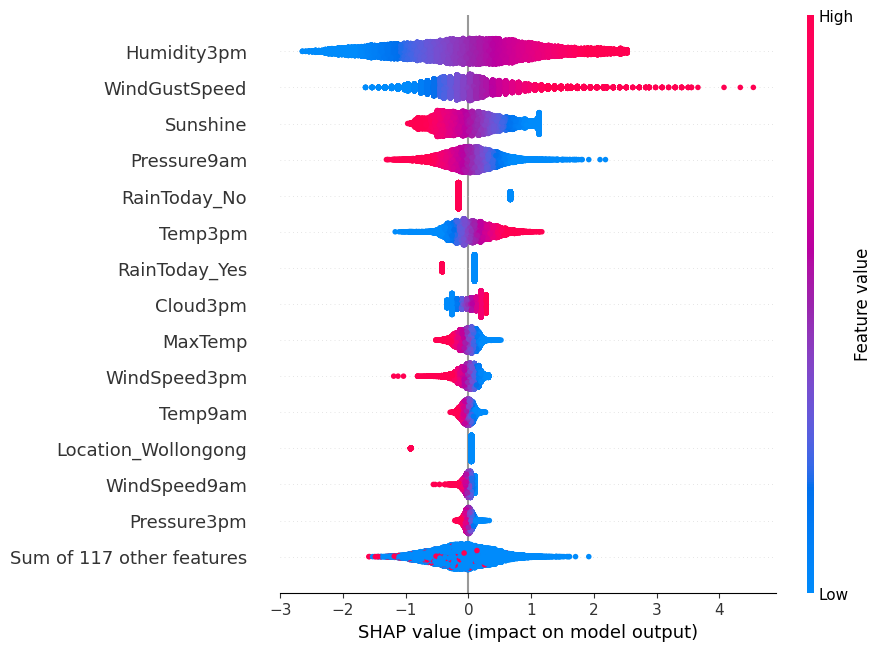

In [95]:
# Using SHAP library to explain the predictions made by logistic regression model
log_explainer = shap.Explainer(regressor, X_train)
log_shap_values = log_explainer(X_test_df)
shap.plots.beeswarm(log_shap_values, max_display=15)

The important features contributing to the prediction in Logistic Model are as follows:
- Humidity3PM
- Pressure3PM
- WindGustSpeed
- Pressure9AM
- Sunshine

The plot is interpreted as follows:
1. The plot is divided into two parts. The left part shows the features' impact on the model output, and the right part shows the feature's value for a given instance.

2. The features are ranked based on their importance, with the most important feature at the top.

3. The color of the feature represents its value for the given instance, with red representing high values and blue representing low values. Here, Humidity3PM's SHAP value is decreasing along with the decrease in their SHAP value

4. Pressure3PM has a high SHAP value when its feature value is low. This represents an inversely proportional relationship between the SHAP and feature value

5. Each point on the plot represents a feature's impact on the prediction for a given instance. WindGustSpeed has a huge cluster of points near zero with outliers of high feature value which represent an increase in the SHAP value

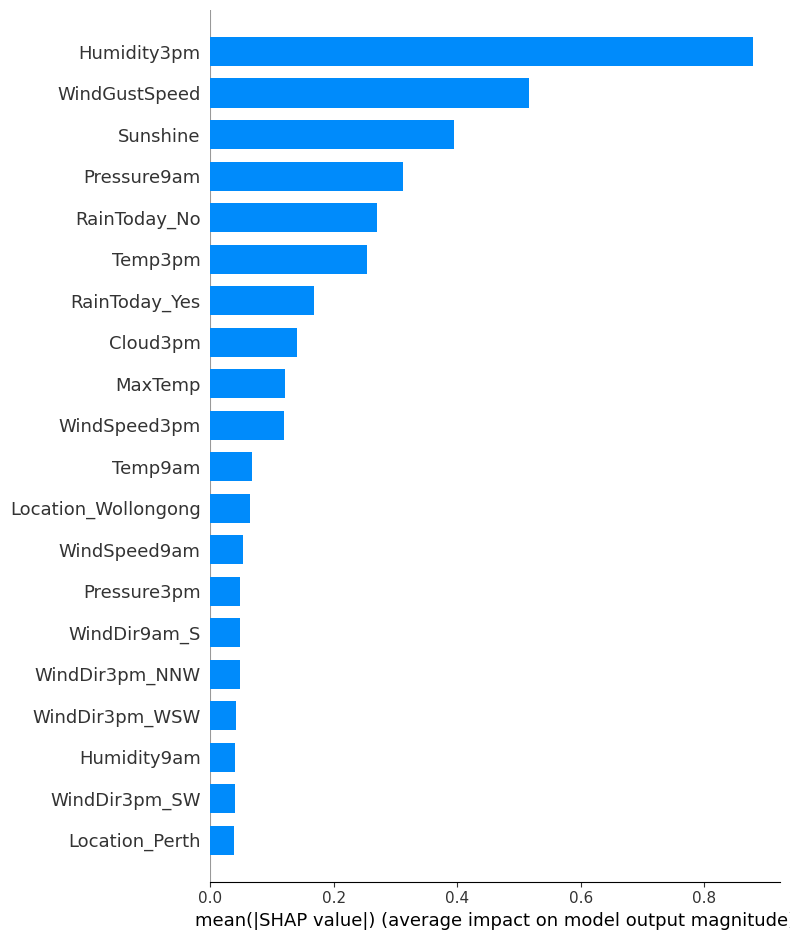

In [96]:
# Plotting a summary plot of SHAP values for each feature in a given sample
shap.summary_plot(log_shap_values, X_train, plot_type="bar")

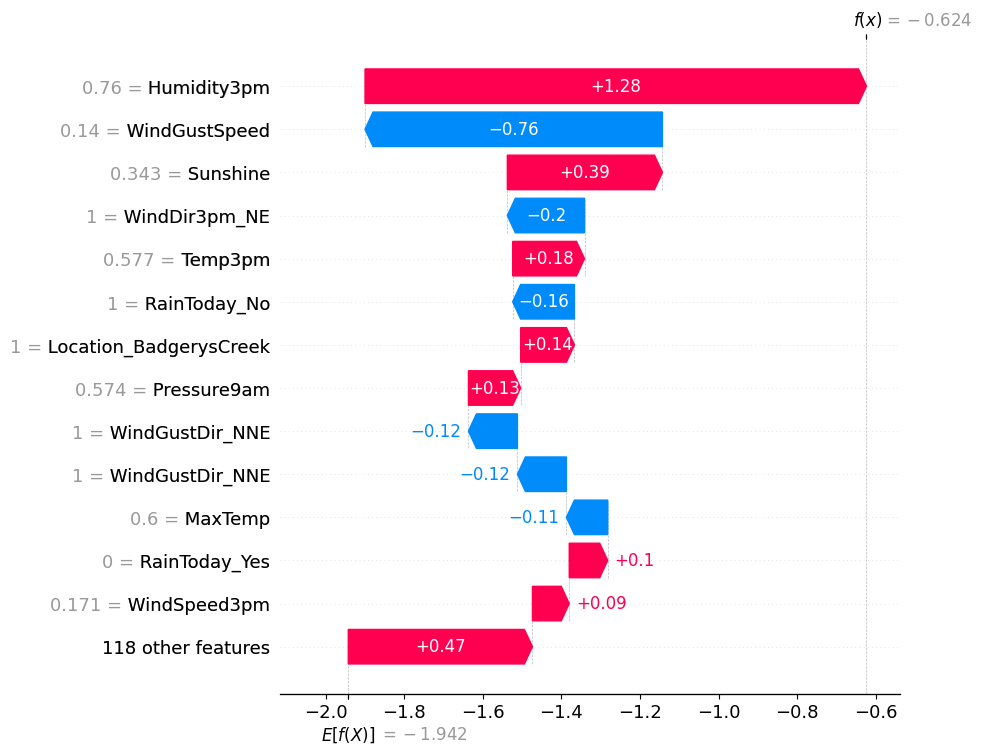

In [97]:
# Plot a Waterfall plot of SHAP values for each feature in a given sample
sample_ind = 18
shap.plots.waterfall(log_shap_values[sample_ind], max_display = 14)


The SHAP Waterfall Plot for Logistic Model is interpreted as follows:

1. Y-axis displays the features of Australian Weather data set used for the prediction whereas X-axis displays the SHAP values indicating the contribution of each feature to the final prediction.
2. The features are sorted based on the magnitude of their contribution with Humidity3PM having the highest contribution of +1.27.
3. The baseline (-1.941) represents the expected prediction based on the average or most common values of all features. The final SHAP value amounts to -0.6225.
4. Humidity3PM has the highest positive impact on the prediction whereas WindGustSpeed has the highest negative impact on the prediction.
5. The top features contributing to the prediction are as follows:
  - Humidity3PM
  - WindGustSpeed
  - Sunshine
  - Pressure3PM
  - WindDir3PM_NE


### Logistic Regression Model PDP Analysis

In [98]:
## Considering 100 samples for SHAP analysis as it is a computationally expensive process
X_train_100 = shap.utils.sample(X_train_plot, 100)
X_test_100 = shap.utils.sample(X_test_plot, 100)

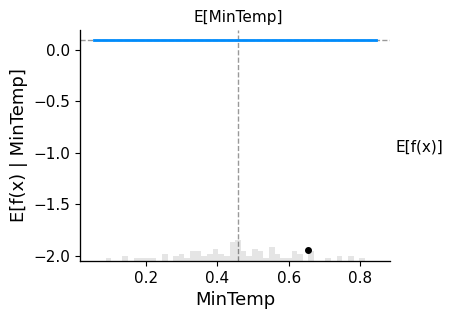

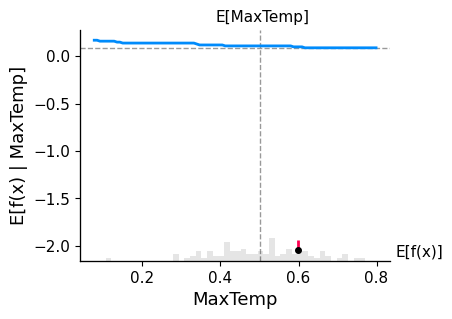

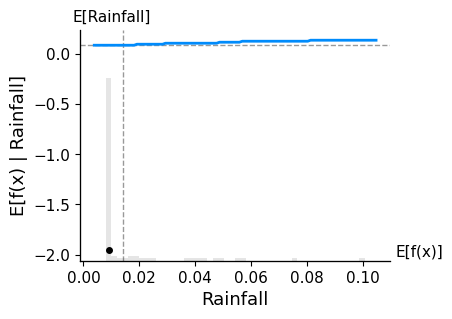

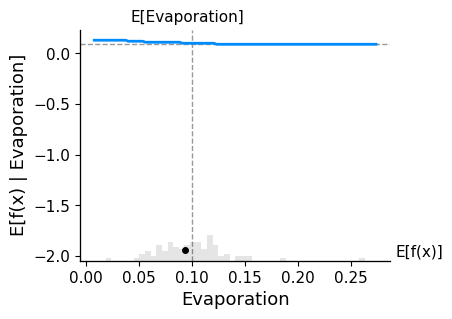

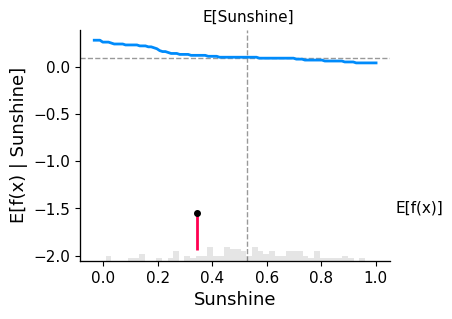

...

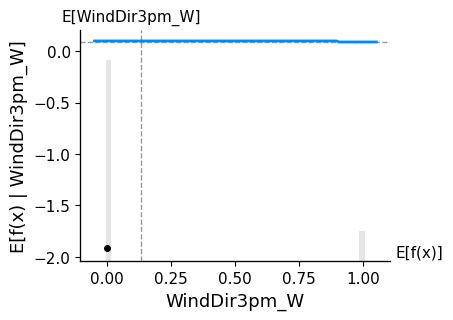

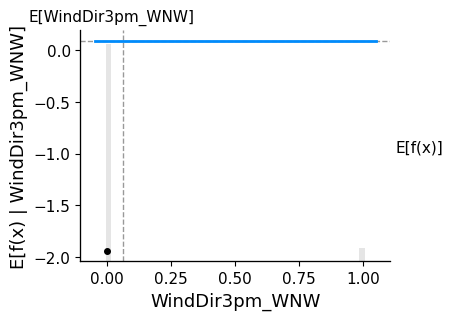

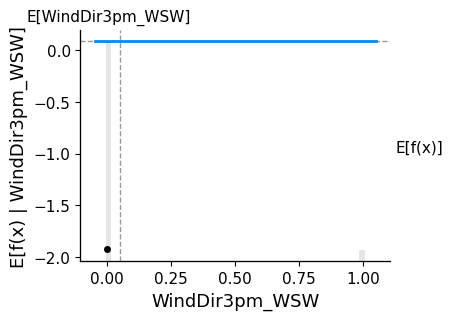

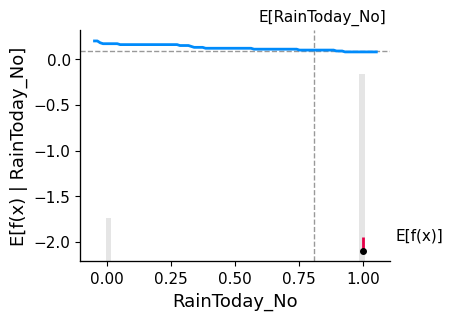

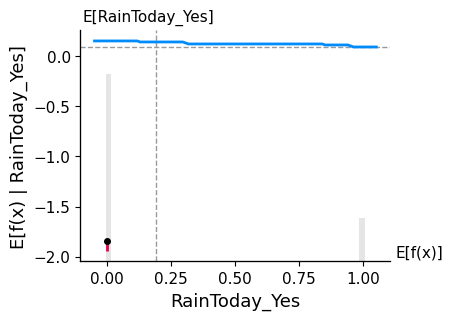

In [99]:
# Generating partial dependence plot using SHAP library for each feature in X_train data
for i in X_train_plot.columns:
    sample_ind = 18
    with plt.rc_context({'figure.figsize': (4, 3)}):
      shap.partial_dependence_plot(i, regressor.predict, X_train_100, model_expected_value=True, feature_expected_value=True, ice=False, shap_values=log_shap_values[sample_ind : sample_ind + 1, :],)
      plt.show()

The Partial Dependence Plot for Logistic Model is interpreted as follows:
1. The X-axis of a partial dependence plot shows the values of the predictor variable being plotted.

2. The Y-axis of a partial dependence plot shows the predicted outcome for each value of the predictor variable.

3. If the curve is a straight line, then the relationship between the predictor variable and the target variable is linear. If the curve is not a straight line, there may be non-linearities or interactions with other variables. As observed from the above plot, MaxTemp has a curved line which indicates multicollinearity among variables.

4. You can determine whether the predictor variable has a positive or negative relationship with the target variable. If the curve is sloping upwards, the relationship is positive, while if the curve is sloping downwards, the relationship is negative. Sunshine has a downward sloping curve which indicates that has a negative relationship with the target variable.

5. The height of the curve can be used to determine the magnitude of the effect of the predictor variable on the predicted outcome. Humidity3PM has a very high upward facing curve which indicates a high magnitude of over 0.5

### Logistic Regression LIME Analysis

In [100]:
# Initializing LIME explainer for Logistic Model
lime_log_explainer = lime_tabular.LimeTabularExplainer(training_data=np.array(X_train), feature_names=X_train_plot.columns, mode='classification')

Prediction :  [0.]
Actual :      1.0


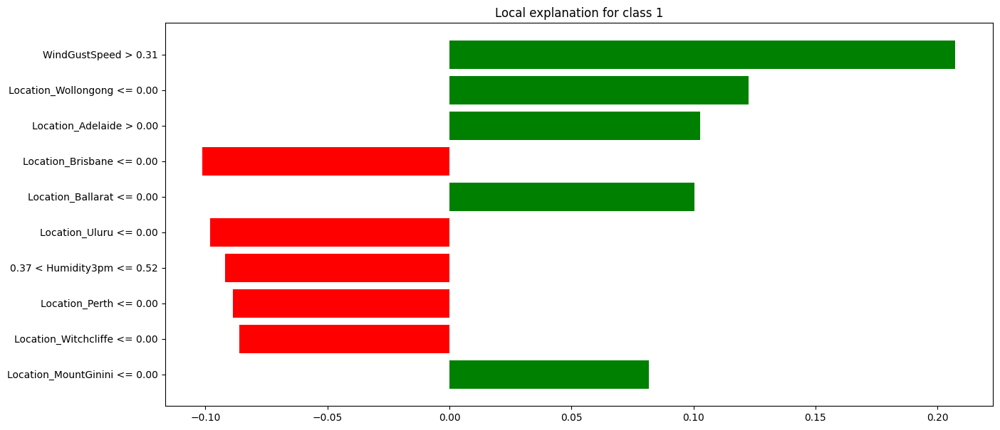

In [101]:
# Getting LIME interpretation for a sample data
idx = 10
lime_log_explanation = lime_log_explainer.explain_instance(X_test_plot.iloc[idx], regressor.predict_proba)

# Printing prediction and actual labels of a single sample
print("Prediction : ", regressor.predict(X_test[0].reshape(1, -1)))
print("Actual :     ", y_test[idx])

# Generating the LIME plot for the sample
with plt.rc_context({'figure.figsize': (15, 7)}):
  fig = lime_log_explanation.as_pyplot_figure()
  plt.show()

In [102]:
# Displaying LIME plot in the Jupyter notebook
lime_log_explanation.show_in_notebook()

The LIME Plot for Logistic Model is interpreted as follows:

1. The vertical bars on the plot show the relative importance of each feature in the prediction. Features with higher bars are more important in the prediction than features with lower bars. In the sample prediction considered above, WindGustSpeed has the highest importance out of all the variables.

2. The color of each bar indicates whether the feature has a positive (blue) or negative (red) impact on the prediction. Blue bars indicate that an increase in the feature value leads to a higher prediction, while orange bars indicate that an increase in the feature value leads to a lower prediction.

3. Here, the overall probability for predicting 0 was 0.42 and probability for predicting 1 was 0.58

4. The width of the bars on the plot indicates the degree of uncertainty in the LIME explanation. Narrow bars indicate high confidence in the explanation, while wide bars indicate lower confidence. All the features to the left contribute to the probability of 0 and features to the right contribute to the probability of 1.

## Light Gradient Boosting Machine

In [103]:
import lightgbm as lgb

# Initializing LightGBM model object with given parameters
params = {'boosting_type': 'gbdt', 'objective': 'binary', 'metric': 'binary_logloss', 'num_leaves': 31, 'learning_rate': 0.05}
lgb_model = lgb.LGBMClassifier(**params)

# Fitting the model on X_train and y_train
lgb_model.fit(X_train, y_train)

# Making predictions on X_train and X_test
y_test_gbm_pred = lgb_model.predict(X_test)

In [104]:
# Assessing the Prediction Values
mae = mean_absolute_error(y_test, y_test_gbm_pred)
mse = mean_squared_error(y_test, y_test_gbm_pred)
r2 = r2_score(y_test, y_test_gbm_pred)

# Printing the results
print("Mean Absolute Error for LightGBM Tree Model:", mae)
print("Mean Squared Error for LightGBM Tree Model:", mse)
print("R-Squared for LightGBM Tree Model:", r2)

Mean Absolute Error for LightGBM Tree Model: 0.13720860128617363
Mean Squared Error for LightGBM Tree Model: 0.13720860128617363
R-Squared for LightGBM Tree Model: 0.2113386075361673


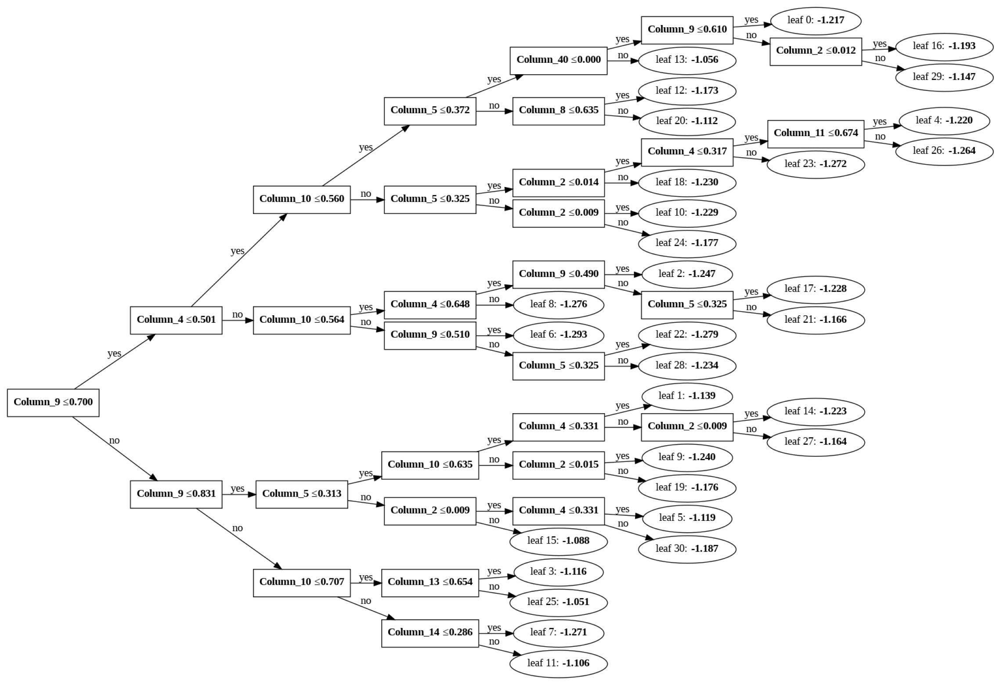

In [105]:
# Visualizing the LightGBM Decision Tree with all its nodes and leaves
fig, ax = plt.subplots(figsize=(50, 20))
lgb.plot_tree(lgb_model, tree_index = 0, ax=ax)
plt.show()

In [106]:
from sklearn.metrics import accuracy_score
# Calculating the accuracy of the model
print('Accuracy Score for Test set = ', round(accuracy_score(y_test, y_test_gbm_pred),4))

Accuracy Score for Test set =  0.8628


## Interpret the Nodes

In [107]:
# Fetching numerical feature importances of the LightGBM model
tree_importances = list(lgb_model.feature_importances_)

# Listing out tuples with variables and their importance
feature_importances = [(feature, round(importance, 2))
    for feature, importance in zip(X_train_plot.columns, tree_importances)
]

# Sorting the feature importances by most important first
feature_importances = sorted(feature_importances, key=lambda x: x[1], reverse=True)

In [108]:
# Inserting the sorted Feature Importance data into a DataFrame
feature_imp = pd.DataFrame(feature_importances, columns=['Feature', 'Importance'])

In [109]:
# Printing the Features and their Importance
feature_imp

,Feature,Importance
0,Humidity3pm,312
1,Pressure9am,296
2,WindGustSpeed,278
3,Pressure3pm,259
4,Sunshine,213
...,...,...
126,WindDir9am_WSW,0
127,WindDir3pm_E,0
128,WindDir3pm_ENE,0
129,WindDir3pm_ESE,0


The nodes of LightGBM Model is interpreted as follows:

- In this case, the feature importance data shows that the "Pressure3pm" feature has the highest importance score of 392, followed by "Humidity3pm" with a score of 354, "WindGustSpeed" with a score of 300, "Sunshine" with a score of 247, and "Rainfall" with a score of 164.

- This suggests that the "Pressure3pm" feature is the most important feature in the LightGBM model's decision-making process, followed by "Humidity3pm", "WindGustSpeed", "Sunshine", and "Rainfall" in descending order of importance.

- For example, in this case, the feature "Pressure3pm" has the highest importance score of 392, which indicates that this feature alone contributes significantly to the model's predictions. On the other hand, "WindDir3pm_E" has a much lower importance score of 0, suggesting that it has almost negligent impact on the model's predictions.

## Analyzing Model Interpretability Methods

### LightGBM Tree Model SHAP Analysis

 99%|===================| 19750/19904 [01:58<00:00]       

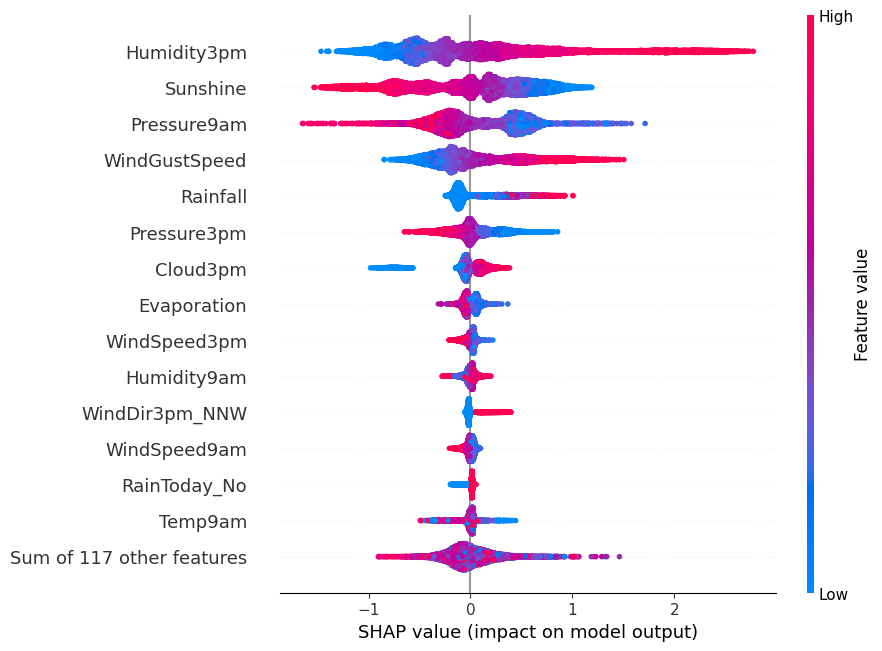

In [110]:
# Using SHAP library to explain the predictions made by LightGBM Model
tree_explainer = shap.Explainer(lgb_model, X_train)
tree_shap_values = tree_explainer(X_test_df, check_additivity=False)
shap.plots.beeswarm(tree_shap_values, max_display=15)

The important features contributing to the prediction in LightGBM Tree Model are as follows:
- Humidity3PM
- Sunshine
- Pressure3PM
- WindGustSpeed
- Rainfall

The plot is interpreted as follows:
1. Unlike the Logistic model's SHAP plot, the Humidity3PM's data is clustered a bit further to the left of the SHAP value. It still follows a directly proportional relationship with the Feature Value.

2. In the Tree Model, Sunshine has a higher feature importance than other features where a low SHAP values leads to a higher feature value. Majority of the values for Sunshine lie below 0 with a medium feature value.

3. Pressure3PM has much fewer outliers in the Tree Model as compared to the Logistic Model. It has a significant amount of points near the zero SHAP value and increasing with increase in feature value.

4. WindGustSpeed's feature importance reduced in the Tree Model and points became highly clustered around the center with reduced outliers.

5. Rainfall was a surprising feature which held very low significance in the Logistic Model having direct relationship between SHAP value and Feature value.

In [111]:
# Using TreeExplainer to compute the SHAP values for the LightGBM model
tree_explainer = shap.TreeExplainer(lgb_model)
tree_shap_values = tree_explainer.shap_values(X_train, approximate = False, check_additivity = False)

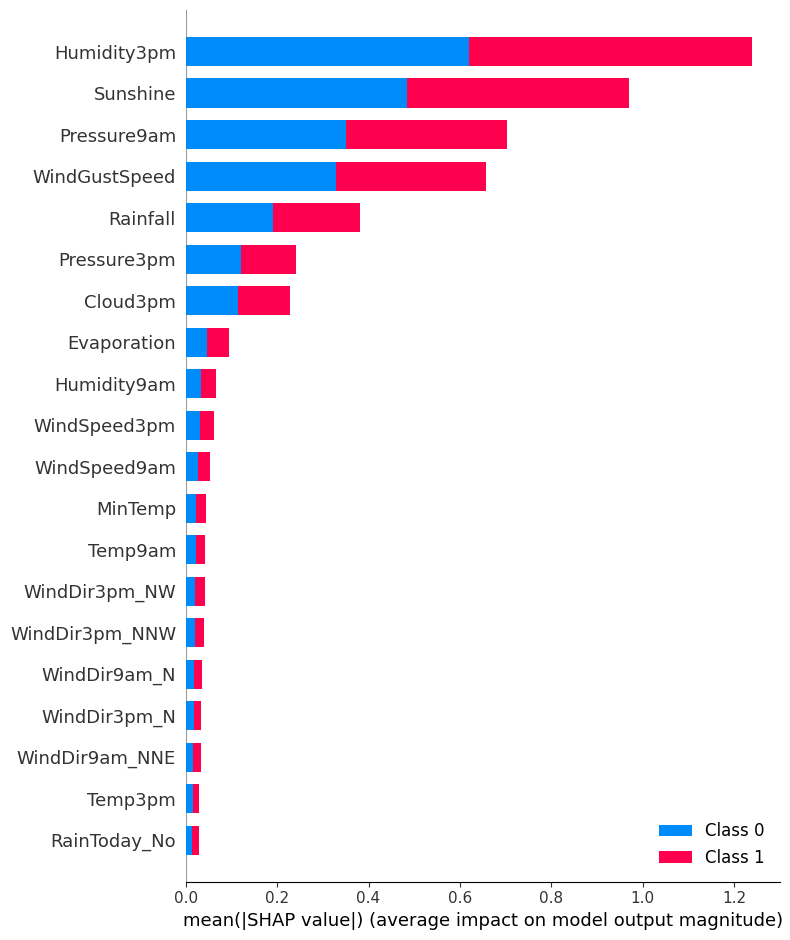

In [112]:
# Plotting the summary plot
shap.summary_plot(tree_shap_values, X_train_plot)

100%|===================| 19829/19904 [01:58<00:00]       

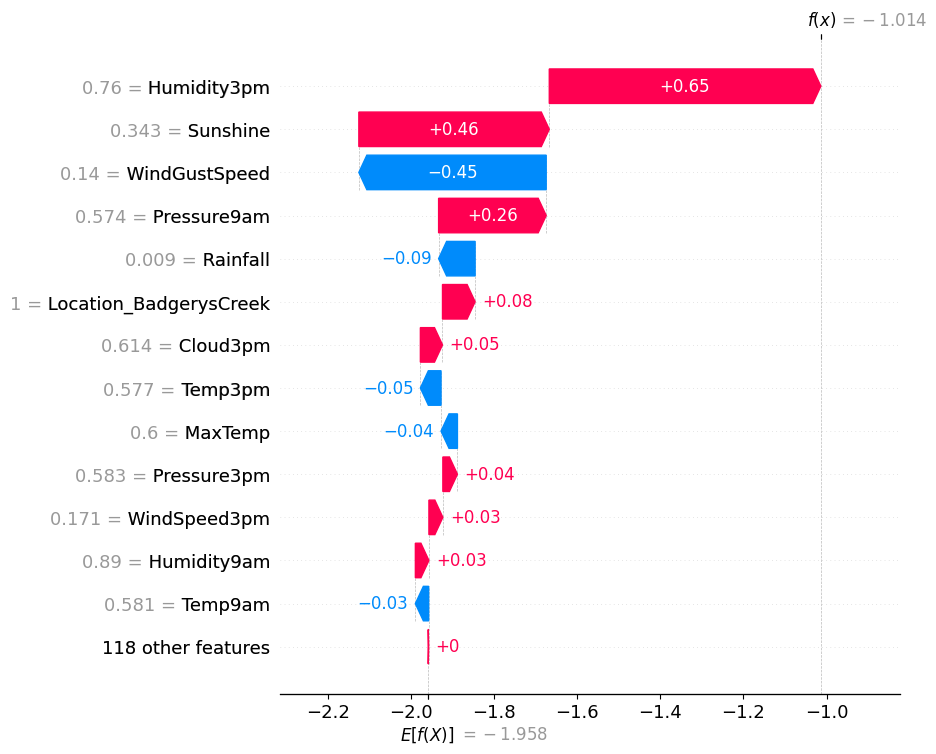

In [113]:
# Plotting the Waterfall plot for Tree model
tree_explainer = shap.Explainer(lgb_model, X_train)
tree_shap_values = tree_explainer(X_test_plot, check_additivity = False)
sample_ind = 18
shap.plots.waterfall(tree_shap_values[sample_ind], max_display=14)

The SHAP Waterfall Plot for Tree Model is interpreted as follows:

1. The Y-axis display the features used for the prediction represented by vertical bars.
2. The X-axis displays the SHAP values indicating the contribution of each feature to the final prediction. SHAP values can be positive or negative, and the higher their absolute value, the more important the feature is in the prediction.
3. The baseline (-1.958) represents the expected prediction based on the average or most common values of all features. It's usually represented by a horizontal line at the center of the plot.
4. Each vertical bar represents the contribution of a feature to the final prediction. A bar above the baseline has a positive impact on the prediction, while a bar below the baseline has a negative impact.
5. Humidity3PM has the highest positive impact on the prediction whereas WindGustSpeed has the highest negative impact on the prediction.
6. Adding up the total contributions of all the features, we receive the final bar which displays the difference between the baseline prediction and the actual prediction made by the model.

### LightGBM Tree PDP Plot

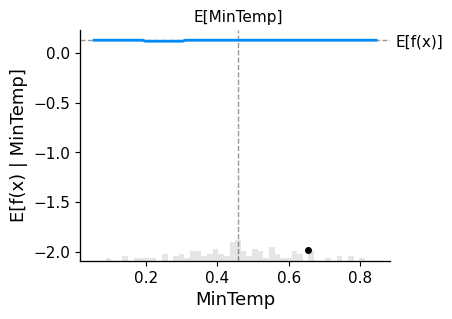

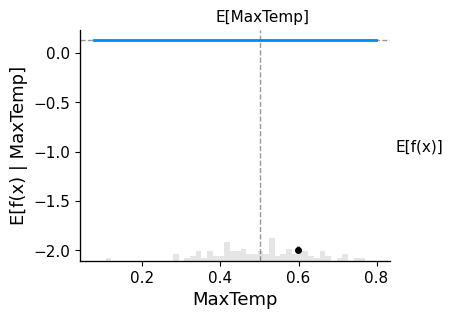

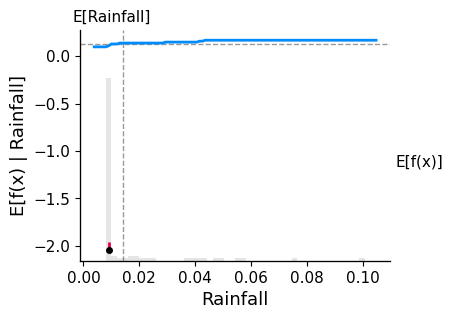

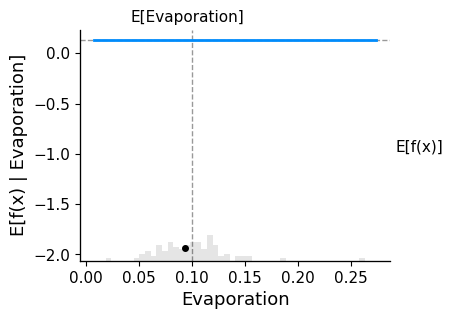

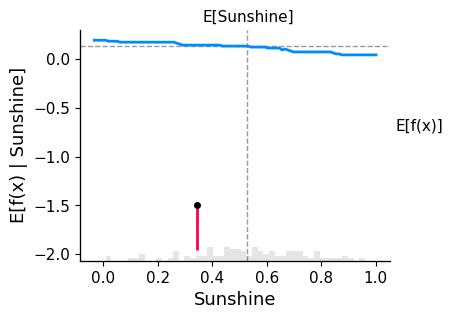

...

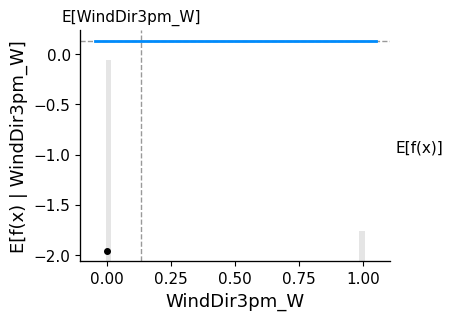

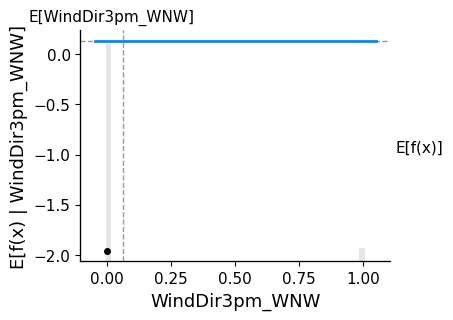

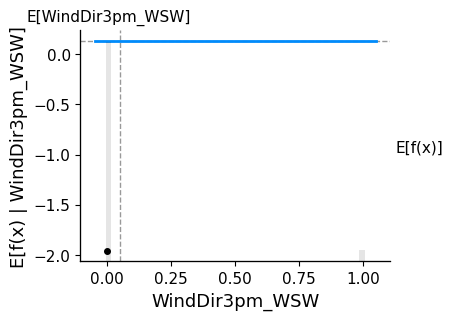

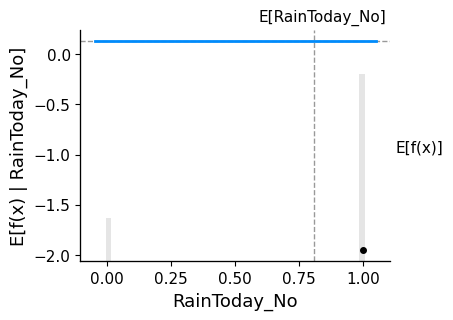

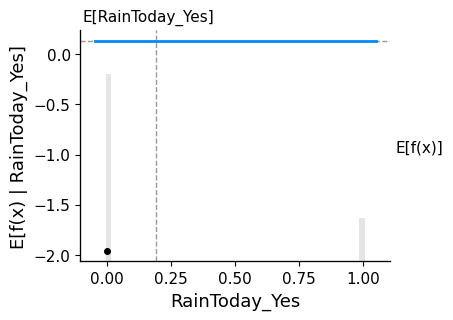

In [114]:
# Computing PDP plots for the tree model
for i in X_train_plot.columns:
    sample_ind = 18
    with plt.rc_context({'figure.figsize': (4, 3)}):
      shap.partial_dependence_plot(i, lgb_model.predict, X_train_100, model_expected_value=True, feature_expected_value=True, ice=False, shap_values=tree_shap_values[sample_ind : sample_ind + 1, :],)

The Partial Dependence Plot for Tree Model is interpreted as follows:
1. The independent variable WindGustSpeed has a curved line which indicates relationship with other variables. 

2. The positive slope of the line indicates a positive relationship with the target variable.

3. The height of the WindGustSpeed line shows a high positive magnitude of effect of the predictor variable on the predicted outcome.

### Tree Model LIME Analysis

In [115]:
# Initializing LIME explainer for Tree Model
lime_tree_explainer = lime_tabular.LimeTabularExplainer(training_data=np.array(X_train), feature_names=X_train_plot.columns, mode='classification')

Prediction :  [0.]
Actual :  1.0


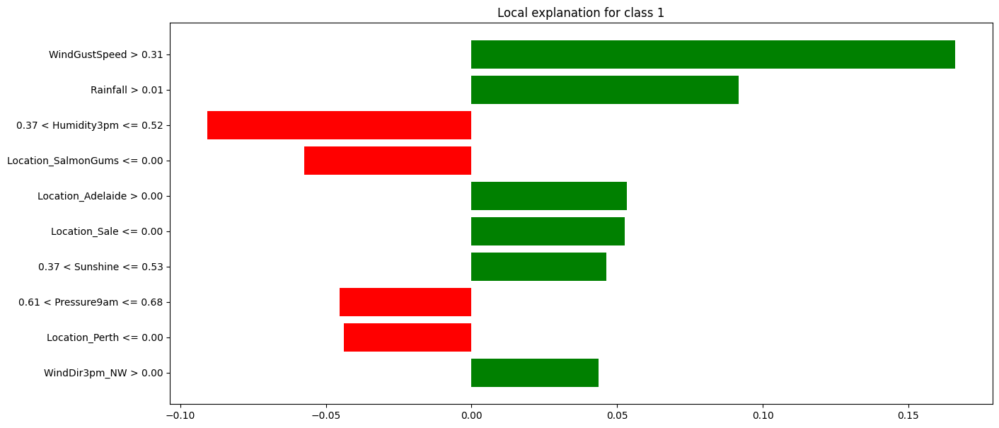

In [116]:
# Getting LIME interpretation for a sample data
idx = 10
lime_tree_explanation = lime_tree_explainer.explain_instance(X_test_plot.iloc[idx], lgb_model.predict_proba)

print("Prediction : ", lgb_model.predict(X_test[0].reshape(1, -1)))
print("Actual : ", y_test[idx])

# Generating the LIME plot for the sample
with plt.rc_context({'figure.figsize': (15, 7)}):
  fig = lime_tree_explanation.as_pyplot_figure()
  plt.show()

In [117]:
# Displaying LIME plot in the Jupyter notebook
lime_tree_explanation.show_in_notebook()

The LIME Plot for Tree Model is interpreted as follows:

1. The above plot describes the features which contributed to the final contribution in the tree model.

2. WindGustSpeed had the highest positive impact on the prediction while Humidity3PM had the highest negative impact on the prediction.

3. The top features being considered for prediction are as follows:
  - WindGustSpeed
  - Humidity3pm
  - Location_Perth
  - Location_Wollongong
  - Pressure3pm

4. The features WindGustSpeed, Location_Wollongong, Location_Adelaide, Rainfall, Location_Hobart and Location_MelbourneAirport contribute to generate the probability of predicting 1 of 0.56

5. The features Humidity3pm, Location_Perth, Pressure3pm and Location_Witchcliffe contribute to generate the probability of predicting 0 of 0.44

## H2O AutoML

H2O AutoML is an automated machine learning platform offered by H2O.ai. It automates the end-to-end machine learning process, including data pre-processing, feature engineering, model selection, hyperparameter tuning, and model deployment.

H2O AutoML automates the process of selecting the best algorithms and hyperparameters for a given dataset by training and comparing multiple models, reducing the time and effort required for manual model selection. It supports a wide range of supervised learning tasks, such as classification and regression, and can handle large datasets with ease.

Refer: https://docs.h2o.ai/h2o/latest-stable/h2o-docs/automl.html

In [118]:
# Displaying categorical data in the DataFrame
categorical_automl_col.head()

,Location,WindGustDir,WindDir9am,WindDir3pm,RainToday
0,Albury,W,W,WNW,No
1,Albury,WNW,NNW,WSW,No
2,Albury,W,ENE,NW,No
3,Albury,WNW,W,W,No
4,Albury,W,SSE,W,No


In [119]:
# Displaying numeric data in the DataFrame
numeric_automl_col.head()

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainTomorrow
0,13.4,22.9,0.6,NaN,NaN,44.0,20.0,24.0,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,0
1,7.4,25.1,0.0,NaN,NaN,44.0,4.0,22.0,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,0
2,17.5,32.3,1.0,NaN,NaN,41.0,7.0,20.0,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,0
3,14.6,29.7,0.2,NaN,NaN,56.0,19.0,24.0,55.0,23.0,1009.2,1005.4,NaN,NaN,20.6,28.9,0
4,7.7,26.7,0.0,NaN,NaN,35.0,6.0,17.0,48.0,19.0,1013.4,1010.1,NaN,NaN,16.3,25.5,0


In [120]:
# Using MICE to impute missing values
imputer = IterativeImputer(random_state=0, n_nearest_features=3)
imputed_numeric_col = pd.DataFrame(imputer.fit_transform(numeric_automl_col), columns = numeric_automl_col.columns)

In [121]:
# Searching for NULL values in the DataFrame
imputed_numeric_col.isnull().sum()

MinTemp          0
MaxTemp          0
Rainfall         0
Evaporation      0
Sunshine         0
WindGustSpeed    0
WindSpeed9am     0
WindSpeed3pm     0
Humidity9am      0
Humidity3pm      0
Pressure9am      0
Pressure3pm      0
Cloud9am         0
Cloud3pm         0
Temp9am          0
Temp3pm          0
RainTomorrow     0
dtype: int64

In [122]:
# Generating a duplicate DataFrame to be used for AutoML implementation
automl_train_df = pd.concat([imputed_numeric_col, categorical_col], axis=1)

In [123]:
# Replacing 0s and 1s in the target variable with N and Y respectively so that it can be considered as a Binary Model
automl_train_df['RainTomorrow'] = automl_train_df['RainTomorrow'].replace({0: 'N', 1: 'Y'})

In [124]:
# Importing H2O Libraries
import h2o
from h2o.automl import H2OAutoML
from h2o.estimators.gbm import H2OGradientBoostingEstimator
from h2o.grid.grid_search import H2OGridSearch

In [125]:
# Setting up the minimum memory size for the AutoML and maximum runtime
min_mem_size = 6
run_time = 222

In [126]:
# Calculating the minimum memory size for the AutoML
import psutil
pct_memory = 0.5
virtual_memory = psutil.virtual_memory()
min_mem_size = int(round(int(pct_memory * virtual_memory.available) / 1073741824, 0))
print(min_mem_size)

3


In [127]:
import random

# Generating a random port number to start the H2O server on
port_no = random.randint(5555, 55555)

# Starting the H2O server and initializing it
try:
    h2o.init(
        strict_version_check=False, min_mem_size_GB=min_mem_size, port=port_no
    )  # start h2o
except:
    logging.critical("h2o.init")
    h2o.download_all_logs(dirname=logs_path, filename=logfile)
    h2o.cluster().shutdown()
    sys.exit(2)

Checking whether there is an H2O instance running at http://localhost:28405..... not found.
Attempting to start a local H2O server...
  Java Version: openjdk version "11.0.18" 2023-01-17; OpenJDK Runtime Environment (build 11.0.18+10-post-Ubuntu-0ubuntu120.04.1); OpenJDK 64-Bit Server VM (build 11.0.18+10-post-Ubuntu-0ubuntu120.04.1, mixed mode, sharing)
  Starting server from /usr/local/lib/python3.9/dist-packages/h2o/backend/bin/h2o.jar
  Ice root: /tmp/tmph6th_84u
  JVM stdout: /tmp/tmph6th_84u/h2o_unknownUser_started_from_python.out
  JVM stderr: /tmp/tmph6th_84u/h2o_unknownUser_started_from_python.err
  Server is running at http://127.0.0.1:28405
Connecting to H2O server at http://127.0.0.1:28405 ... successful.


H2O_cluster_uptime:,03 secs
H2O_cluster_timezone:,Etc/UTC
H2O_data_parsing_timezone:,UTC
H2O_cluster_version:,3.40.0.3
H2O_cluster_version_age:,5 days
H2O_cluster_name:,H2O_from_python_unknownUser_u5tc25
H2O_cluster_total_nodes:,1
H2O_cluster_free_memory:,3.172 Gb
H2O_cluster_total_cores:,2
H2O_cluster_allowed_cores:,2
H2O_cluster_status:,"locked, healthy"


In [128]:
# Converting the DataFrame to H2O DataFrame
h2o_df = h2o.H2OFrame(automl_train_df)

Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%


In [129]:
# Splitting the data into training and testing datasets
df_train, df_test = h2o_df.split_frame([0.80])

In [130]:
# Setting up the AutoML Model
def autoML(df_train, df_test):
    X = df_train.columns
    y = "RainTomorrow"
    X.remove(y)  # Removing the result frm our predictors data

    aml = H2OAutoML(max_runtime_secs=222, seed=1)
    aml.train(x=X, y=y, training_frame=df_train)  # Training the dataset on different models
    return df_train, df_test, aml

In [131]:
# Function to get best model from the AutoML leaderboard
def getBestModel(aml):
    model_index = 0
    glm_index = 0
    glm_model = ""
    aml_leaderboard_df = aml.leaderboard.as_data_frame()
    models_dict = {}
    # Looping through the models to get the best model index
    for m in aml_leaderboard_df["model_id"]:
        models_dict[m] = model_index
        if "StackedEnsemble" not in m:
            break
        model_index = model_index + 1

    # Looping through the models to get the GLM model index
    for m in aml_leaderboard_df["model_id"]:
        if "GLM" in m:
            models_dict[m] = glm_index
            break
        glm_index = glm_index + 1

    print(model_index)
    best_model = h2o.get_model(aml.leaderboard[model_index, "model_id"])
    return best_model

In [132]:
# Training the AutoML Model
autoML = autoML(df_train, df_test)

AutoML progress: |███████████████████████████████████████████████████████████████| (done) 100%


In [133]:
# Outputting the leaderboard of the AutoML model
autoML[2].leaderboard

model_id,auc,logloss,aucpr,mean_per_class_error,rmse,mse
StackedEnsemble_AllModels_2_AutoML_1_20230410_03825,0.895291,0.321124,0.75362,0.194656,0.315615,0.099613
StackedEnsemble_BestOfFamily_3_AutoML_1_20230410_03825,0.894638,0.321859,0.75134,0.19457,0.316315,0.100055
StackedEnsemble_AllModels_1_AutoML_1_20230410_03825,0.894572,0.322444,0.751468,0.201684,0.316582,0.100224
StackedEnsemble_BestOfFamily_2_AutoML_1_20230410_03825,0.89364,0.323715,0.747599,0.194848,0.317536,0.100829
StackedEnsemble_BestOfFamily_1_AutoML_1_20230410_03825,0.892484,0.324857,0.749055,0.198874,0.317631,0.10089
GBM_2_AutoML_1_20230410_03825,0.891795,0.327612,0.743644,0.205198,0.320039,0.102425
GBM_5_AutoML_1_20230410_03825,0.889592,0.329018,0.743565,0.208101,0.319833,0.102293
GBM_1_AutoML_1_20230410_03825,0.88895,0.331491,0.742604,0.208433,0.320924,0.102992
GBM_3_AutoML_1_20230410_03825,0.887933,0.330827,0.743004,0.212554,0.320486,0.102711
GBM_4_AutoML_1_20230410_03825,0.887651,0.336238,0.735314,0.206386,0.32363,0.104736


In [134]:
# Getting the best model from the AutoML leaderboard
autoML_model = getBestModel(autoML[2])
print(autoML_model)

5
Model Details
H2OGradientBoostingEstimator : Gradient Boosting Machine
Model Key: GBM_2_AutoML_1_20230410_03825


Model Summary: 
    number_of_trees    number_of_internal_trees    model_size_in_bytes    min_depth    max_depth    mean_depth    min_leaves    max_leaves    mean_leaves
--  -----------------  --------------------------  ---------------------  -----------  -----------  ------------  ------------  ------------  -------------
    100                100                         150162                 7            7            7             60            128           102.46

ModelMetricsBinomial: gbm
** Reported on train data. **

MSE: 0.06442330193708835
RMSE: 0.25381745790447185
LogLoss: 0.22418412107534733
Mean Per-Class Error: 0.13443570864247065
AUC: 0.9579330720986214
AUCPR: 0.901549127521339
Gini: 0.9158661441972429

Confusion Matrix (Act/Pred) for max f1 @ threshold = 0.40194097684054686
       N      Y      Error    Rate
-----  -----  -----  -------  ----------------

In [135]:
# Making predictions using the best model
autoML_model.predict(df_test)

gbm prediction progress: |███████████████████████████████████████████████████████| (done) 100%


predict,N,Y
Y,0.446597,0.553403
N,0.943869,0.0561309
N,0.976787,0.023213
N,0.951,0.0489995
N,0.980361,0.0196393
N,0.943691,0.0563093
N,0.89921,0.10079
N,0.944592,0.0554081
N,0.994468,0.00553152
N,0.98535,0.0146504


# Confusion Matrix

> Confusion matrix shows a predicted class vs an actual class.

## GBM_2_AutoML_1_20230410_03825

,N,Y,Error,Rate
N,13445.0,2028.0,0.1311,(2028.0/15473.0)
Y,1212.0,3266.0,0.2707,(1212.0/4478.0)
Total,14657.0,5294.0,0.1624,(3240.0/19951.0)


# Learning Curve Plot

> Learning curve plot shows the loss function/metric dependent on number of iterations or trees for tree-based algorithms. This plot can be useful for determining whether the model overfits.

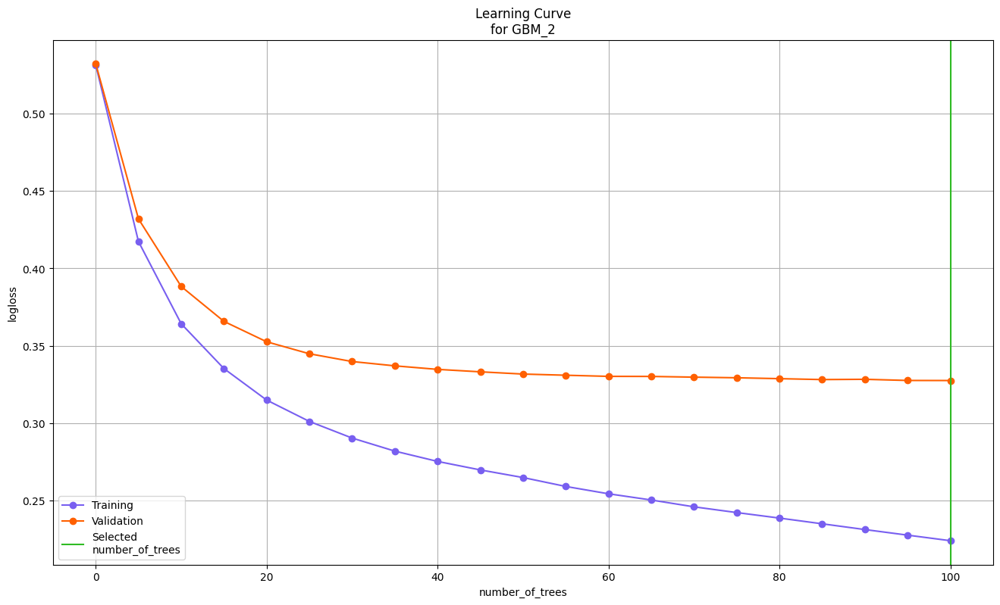

# Variable Importance

> The variable importance plot shows the relative importance of the most important variables in the model.

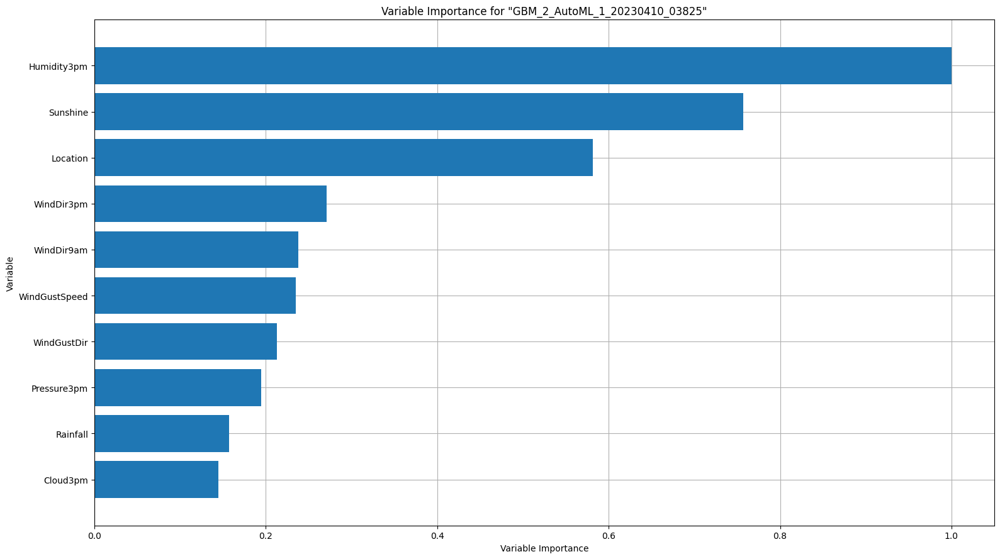

# SHAP Summary

> SHAP summary plot shows the contribution of the features for each instance (row of data). The sum of the feature contributions and the bias term is equal to the raw prediction of the model, i.e., prediction before applying inverse link function.

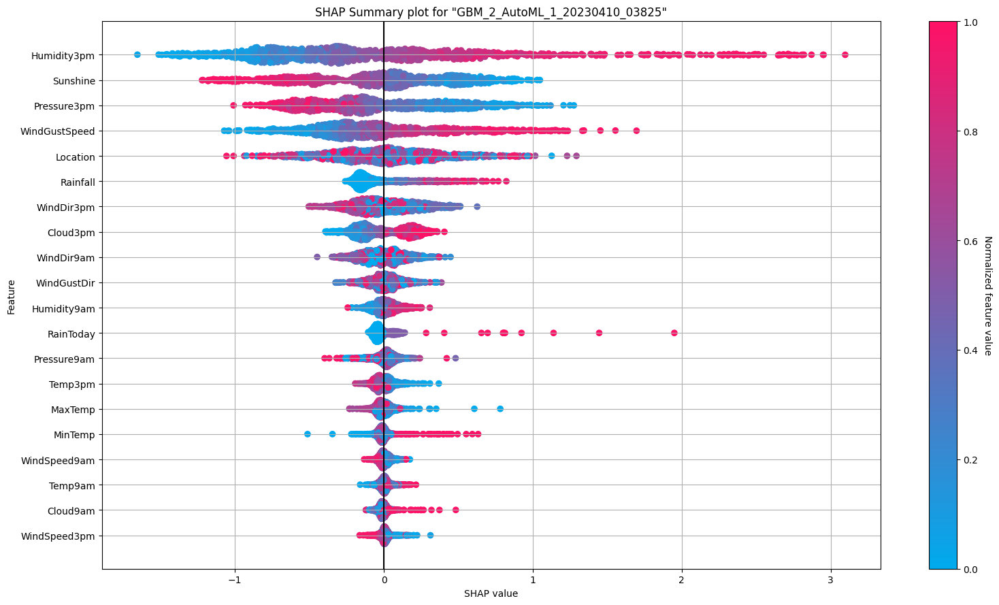

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

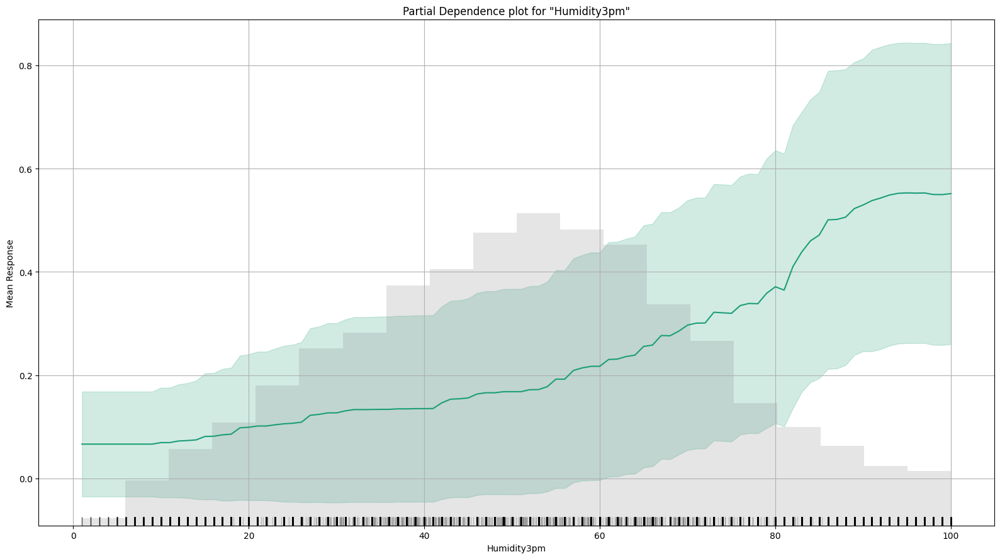

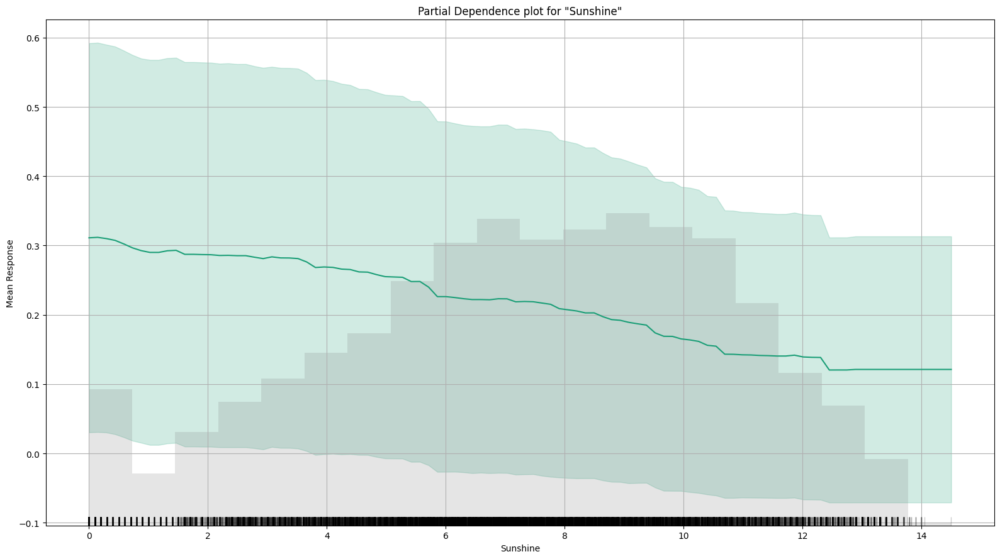

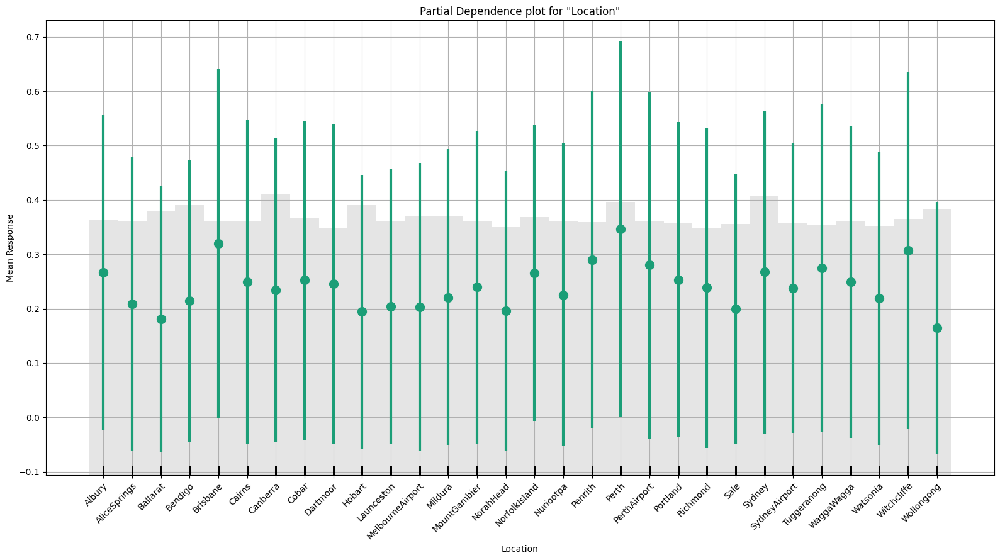

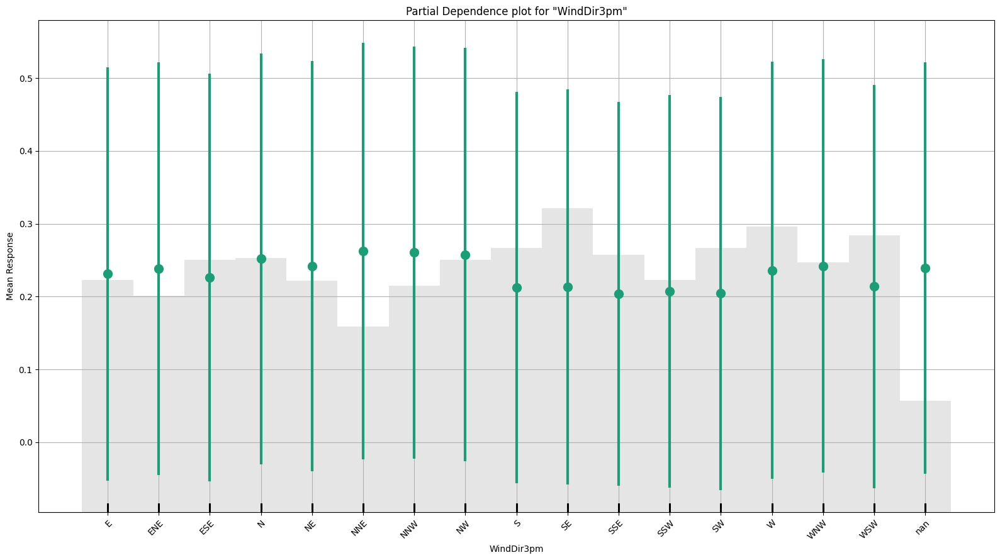

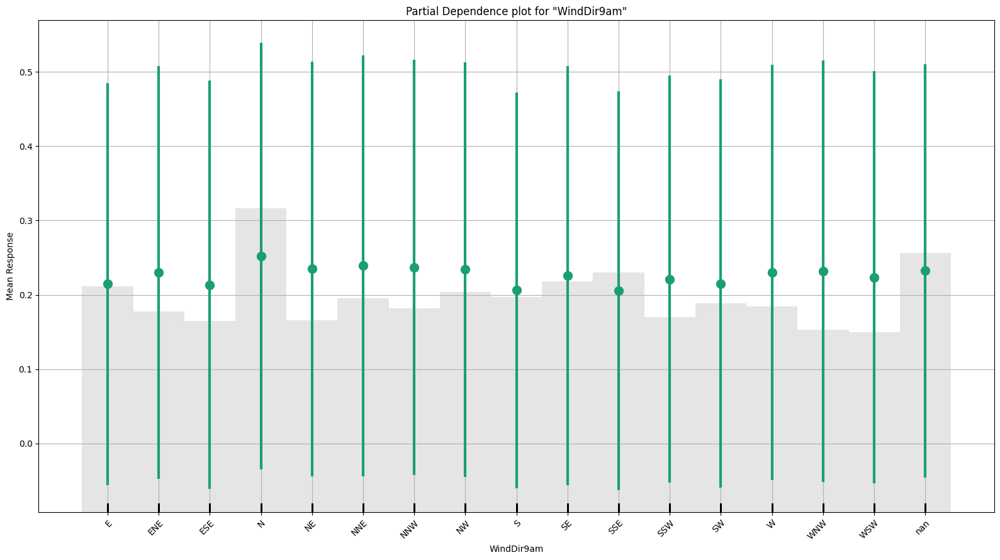

# Confusion Matrix

> Confusion matrix shows a predicted class vs an actual class.

## GBM_2_AutoML_1_20230410_03825

,N,Y,Error,Rate
N,13445.0,2028.0,0.1311,(2028.0/15473.0)
Y,1212.0,3266.0,0.2707,(1212.0/4478.0)
Total,14657.0,5294.0,0.1624,(3240.0/19951.0)


# Learning Curve Plot

> Learning curve plot shows the loss function/metric dependent on number of iterations or trees for tree-based algorithms. This plot can be useful for determining whether the model overfits.

# Variable Importance

> The variable importance plot shows the relative importance of the most important variables in the model.

# SHAP Summary

> SHAP summary plot shows the contribution of the features for each instance (row of data). The sum of the feature contributions and the bias term is equal to the raw prediction of the model, i.e., prediction before applying inverse link function.

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

In [136]:
# Generating explanations for the predictions made by the best model
autoML_model.explain(autoML[1])

### H2O Model SHAP Analysis

The SHAP Model for H2O AutoML Model is interpreted as follows:

The important features contributing to the SHAP analysis are as follows:
- Humidity3PM
- Sunshine
- Pressure3PM
- WindGustSpeed
- Location

The plot is interpreted as follows:
1. The independent variable Humidity3PM has a huge cluster of points to the left of zero with some outliers on the right. It has a directly proportional relationship with the SHAP values.

2. The SHAP values for Sunshine is decreasing with increase in feature value. It has majority of its points below zero.

3. Pressure3PM also has an inverse relationship with the SHAP value. It has a few outliers with positive SHAP value but they're mostly grouped to the left.

4. WindGustSpeed's points are spread on both the sides with an increase in SHAP value based on the increase in Feature value.

5. Location was a feature which did not have a high feature importance in Logistic and LightGBM models. It has a huge variety of data which indicates a complex relationship between the SHAP and feature values.

### H2O Model Partial Dependence Plot

The Partial Dependence Plot for H2O Model is interpreted as follows:
1. As shown above, the partial dependence plot for Humidity3PM shows a curved line with positive slope which indicates multicollinearity with other variables and positive relationship with target variable.

2. Sunshine has a negative curve which means that it has negative relationship with the target variable and the height indicates a high magnitude of impact on the prediction.

3. Location, which is a categorical variable whose PDP plot depicts all the locations on X-axis and its mean response on the Y-axis. Locations like Adelaide, Brisbane and Perth have strong weightage on the final prediction.

4. WindDir3PM, which is also a categorical variable with a varied range of mean responses for each feature type.

5. WindGustSpeed has a positive curve which starts to become constant as the feature value increases. It has a significant magnitude along with positive relationship with the target variable.

## Questions:

### 1. What is the question?
The objective of this report is to combine the following components of the project into a single report as follows:
- Data Cleaning and Feature Selection 
  
  We identify and correct or remove errors, inconsistencies, and inaccuracies in the dataset. Further, we select a subset of relevant features or variables that have the most significant impact on the target variable.

- AutoML

  We make use of AutoML libraries like H2O to develop predictive models and interpret them.

- Model Interpretability

  We understand the results and decision-making process of the model, including identifying the most important features and their impact on the target variable.

### 2. What did you do?
- We performed data cleaning, feature selection, modeling, and interpretability on the Australian weather data to predict rain for tomorrow. 
- First of all, we performed data cleaning and feature selection to identify the significant predictors and build a logistic regression model that accurately predicted rain. 
- Then, we used an AutoML library, H2O AutoML, to explore different algorithm options and create multivariate models to predict rainfall, which simplified the model development process and provided insights into underlying patterns in the weather data. 
- Finally, we interpreted various models using SHAP analysis, PDP Plots and LIME Analysis to gain valuable insights into their decision-making process and emphasized the importance of interpretability in machine learning models.

### 3. How well did it work?
- In the Data Cleaning and Feature Selection section of the analysis, we used Logistic Regression to build a model that accurately predicted rain for tomorrow, achieving a high accuracy of 84%.

- In the AutoML section of the analysis, H2O AutoML was used to explore different algorithm options and create multivariate models to predict rainfall. Through this approach, we were able to achieve the same high accuracy of 84%.

- In the Model Interpretability section, we used LightGBM Tree Model to build a model that achieved an even higher accuracy of 86%. By interpreting the coefficients of the Logistic Regression model, the nodes of the tree-based model, and conducting SHAP analysis on the AutoML model, the team was able to gain valuable insights into the decision-making processes of each model.

- Overall, we were able to achieve high accuracy in predicting rain for tomorrow through the use of different modeling techniques and approaches. However, it is worth noting that interpretability is crucial for understanding the underlying patterns in the data and gaining valuable insights into the decision-making processes of machine learning models.

### 4. What did you learn?
- The report used a comprehensive approach that involved data cleaning, feature selection, modeling, and interpretability to predict rain for the following day. 
- The results indicated that logistic regression achieved an 84% accuracy rate in predicting rain after data cleaning and feature selection. 
- The use of H2O AutoML in the modeling phase also resulted in an 84% accuracy rate. 
- In the interpretability phase, the LightGBM Tree model achieved an 86% accuracy rate. 
- Additionally, the analysis emphasized the importance of interpretability in machine learning models to gain valuable insights into their decision-making process. 
- Finally, we interpreted our predictive models using SHAP analysis, revealing that the logistic model provided straightforward insights, the tree-based model had a complex decision-making process, and the Auto-ML model had limited interpretability.
- Overall, the study highlights the usefulness of a comprehensive approach to data analysis and model development in achieving accurate predictions and gaining insights into the underlying patterns in the data.





## Conclusion
In conclusion, this notebook demonstrates the effectiveness of combining data cleaning, feature selection, modeling, and interpretability to predict rainfall for tomorrow using Australian weather data. The results show that logistic regression provides accurate predictions, while AutoML simplifies the model development process and provides insights into underlying patterns. However, the report highlights the importance of interpretability to gain valuable insights into the decision-making process of machine learning models. This study has implications for improving the accuracy and interpretability of predictive models in various fields.

## References
We have referred the following links and websites to understand the machine learning concepts:

1. GeeksforGeeks
2. towardsdatascience
3. scikitlearn documentation
4. StatQuest with Josh Starmer
5. SHAP documentation
6. H2O AutoML documentation
7. statsmodel
8. analyticsvidhya
9. statology
10. eli5 documentation

Specific links have been provided within the notebook for detailed reference. We referred matplotlib and seaborn documentation for preparing data visualizations. Rest of the code is written individually with reference to the previous assignments.

MIT License

Copyright (c) 2022 Draconian10

Permission is hereby granted, free of charge, to any person obtaining a copy
of this software and associated documentation files (the "Software"), to deal
in the Software without restriction, including without limitation the rights
to use, copy, modify, merge, publish, distribute, sublicense, and/or sell
copies of the Software, and to permit persons to whom the Software is
furnished to do so, subject to the following conditions:

The above copyright notice and this permission notice shall be included in all
copies or substantial portions of the Software.

THE SOFTWARE IS PROVIDED "AS IS", WITHOUT WARRANTY OF ANY KIND, EXPRESS OR
IMPLIED, INCLUDING BUT NOT LIMITED TO THE WARRANTIES OF MERCHANTABILITY,
FITNESS FOR A PARTICULAR PURPOSE AND NONINFRINGEMENT. IN NO EVENT SHALL THE
AUTHORS OR COPYRIGHT HOLDERS BE LIABLE FOR ANY CLAIM, DAMAGES OR OTHER
LIABILITY, WHETHER IN AN ACTION OF CONTRACT, TORT OR OTHERWISE, ARISING FROM,
OUT OF OR IN CONNECTION WITH THE SOFTWARE OR THE USE OR OTHER DEALINGS IN THE
SOFTWARE.